In [1]:
import math
import random
from typing import Tuple
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import csv
random.seed(10)

In [2]:
import pickle
from pathlib import Path

# Structure: (theta, phi) -> (theta_etilt, phi_scan)
saved_tp = dict()
saved_tp_file = Path("t4p4.pkl")
if saved_tp_file.is_file():
    with open(saved_tp_file, "rb") as f:
        saved_tp = pickle.load(f)
        
# Structure: (segment, polygon) -> (boolean True or False)
saved_los = dict()

saved_los_file = Path("los4.pkl")
if saved_los_file.is_file():
    with open(saved_los_file, "rb") as f:
        saved_los = pickle.load(f)

In [3]:
!pip install Geometry3D shapely

In [4]:
from Geometry3D import *
from shapely import geometry

In [5]:
data = pd.read_csv("C:\\Users\\tniloy\\Downloads\\opencellid dataset\\310.csv", names=['radio', 'mcc', 'mnc', 'lac', 'cid', 'unit', 'longitude', 'latitude', 'range', 'samples', 'changeable', 'created', 'updated', 'averageSignal'])

In [6]:
data.head (10)

,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
0,GSM,310,260,32192,22568,0,-73.858566,40.898438,1779,12,1,1459696254,1489125559,0
1,GSM,310,260,22629,61562,0,-95.876501,41.286475,3367,17,1,1459810860,1609205988,0
2,GSM,310,260,51052,44152,0,-71.084483,42.381728,1000,44,1,1459812328,1514115939,0
3,GSM,310,260,51051,40311,0,-71.085559,42.381356,1000,52,1,1459812328,1527695374,0
4,GSM,310,260,5973,60092,0,-95.570630,29.735371,1000,22,1,1459692332,1490851584,0
5,GSM,310,410,19007,7133,0,-87.258205,40.153886,19135,6,1,1459699529,1472415099,0
6,GSM,310,410,53005,50671,0,-95.563889,30.280380,1000,1,1,1459775023,1459775023,0
7,GSM,310,260,46136,15418,0,-76.999741,39.160080,1000,1,1,1459663271,1459663271,0
8,GSM,310,410,27672,59021,0,-81.741964,26.213691,1000,11,1,1459687298,1491031828,0
9,GSM,310,260,5973,50942,0,-95.560226,29.736557,1000,6,1,1459692332,1469493454,0


In [7]:
# center_x = 0
# center_y = 0
# center_z = 0
# FSS POsition:
lat_FSS= 37.20250
lon_FSS= -80.43444
R  = 6.371e6  #Radius of the earth

x_FSS = R * math.cos(math.radians(lat_FSS)) * math.cos(math.radians(lon_FSS))
y_FSS = R * math.cos(math.radians(lat_FSS)) * math.sin(math.radians(lon_FSS))
z_FSS = R * math.sin(math.radians(lat_FSS))

print("X, Y, Z = "+ str([x_FSS, y_FSS, z_FSS]))


radius=5000 #radius of the inclusion zone
latitude_range = radius / 110574
longitude_range = radius/(111320*math.cos(math.radians(latitude_range)))
print("Total area of inclusion zone is = " + str(radius*radius*math.pi))

X, Y, Z = [843264.3231973607, -5003968.368478095, 3852122.3823358943]
Total area of inclusion zone is = 78539816.33974482


In [8]:
print(latitude_range)
print(longitude_range)

0.04521858664785573
0.044915572737550945


In [9]:
data_within_zone = data[(data['radio'] == 'GSM') & (data['longitude'] <= (lon_FSS + longitude_range)) & (data['longitude'] >= (lon_FSS - longitude_range)) & (data['latitude'] <= (lat_FSS + latitude_range)) & (data['latitude'] >= (lat_FSS - latitude_range))]

data_within_zone.head(10)


,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
780410,GSM,310,260,37630,43582,0,-80.393175,37.196127,8733,3992,1,1413757287,1435049916,0
1813932,GSM,310,260,32453,43561,0,-80.421524,37.189560,1000,9,1,1458834001,1491931840,0
1813934,GSM,310,260,32453,43602,0,-80.410309,37.233810,1000,6,1,1458834001,1479555225,0
1814053,GSM,310,260,32453,43822,0,-80.406704,37.227516,1000,8,1,1458834001,1479576548,0
1814075,GSM,310,260,32453,43583,0,-80.461073,37.203233,2207,15,1,1458834001,1477155991,0
1814213,GSM,310,260,32453,43581,0,-80.409897,37.217972,1000,5,1,1458834001,1473235293,0
1814220,GSM,310,260,32453,43601,0,-80.425186,37.236099,1000,6,1,1458834001,1473191254,0
1814361,GSM,310,260,32453,43562,0,-80.391645,37.165063,1000,11,1,1458834001,1489446412,0
1814366,GSM,310,260,32453,43603,0,-80.425415,37.222710,1000,4,1,1458834001,1474352285,0
1814368,GSM,310,260,32453,43621,0,-80.393486,37.224279,1033,56,1,1458834001,1482422269,0


In [10]:
len(data_within_zone)

33

In [11]:
import json
with open ('C:\\Users\\tniloy\\Downloads\\export (1).geojson') as f:
    df=json.load(f)
    data1=pd.json_normalize(df,record_path=['features'])
data1.head(10)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Feature,relation/548333,relation/548333,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Feature,relation/548339,relation/548339,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Feature,relation/548344,relation/548344,1406,Giles Road,church,NaN,Blacksburg First Wesleyan Church,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Feature,relation/548347,relation/548347,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,Feature,relation/548348,relation/548348,NaN,NaN,residential,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,Feature,relation/548371,relation/548371,1416,Palmer Drive,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Feature,relation/548372,relation/548372,900,Dickerson Lane,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Feature,relation/548373,relation/548373,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Feature,relation/548386,relation/548386,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [12]:
data1[data1["properties.height"].notnull()].head(20)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
33,Feature,relation/1360465,relation/1360465,NaN,NaN,university,14.86,East Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
34,Feature,relation/1360466,relation/1360466,NaN,NaN,dormitory,14.86,West Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35,Feature,relation/1360467,relation/1360467,NaN,NaN,dormitory,11.27,Slusher Wing,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36,Feature,relation/1360468,relation/1360468,NaN,NaN,dormitory,33.59,Slusher Tower,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
37,Feature,relation/1360469,relation/1360469,NaN,NaN,dormitory,14.86,Main Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
66,Feature,way/26210227,way/26210227,NaN,NaN,university,15.47,Cheatham Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
67,Feature,way/26210236,way/26210236,285,Ag Quad Lane,university,11.57,Dietrick Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
69,Feature,way/32709325,way/32709325,570,Washington Street Southwest,dormitory,25.82,Hoge Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
98,Feature,way/32953606,way/32953606,210,Drillfield Drive,university,11.61,Sandy Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
data1["geometry.coordinates"].head(10)

0    [[[-80.4194702, 37.2238774], [-80.4194505, 37....
1    [[[-80.4070717, 37.2320238], [-80.4069865, 37....
2    [[[-80.4068521, 37.2319488], [-80.4069373, 37....
3    [[[-80.4104274, 37.2506844], [-80.4104412, 37....
4    [[[-80.4355296, 37.2138316], [-80.4355103, 37....
5    [[[-80.4416012, 37.2238365], [-80.4417281, 37....
6    [[[-80.3924701, 37.2185727], [-80.3923812, 37....
7    [[[-80.4121293, 37.2397986], [-80.4121648, 37....
8    [[[-80.4075916, 37.2253453], [-80.4076676, 37....
9    [[[-80.4071473, 37.2322051], [-80.4072218, 37....
Name: geometry.coordinates, dtype: object

In [14]:
class Building:
    def __init__(self, coordinates=None, height=None):
        self.coordinates = []
        if coordinates is not None:
            self.coordinates = coordinates
        
        if height is None or not str(height).isdigit():
            self.height = random.uniform(10, 40)
        else:
            self.height = height
        
        self.x_coord, self.y_coord, self.z_coord = self.latlon_to_XYZ()
        
        self.points = []
        for i in range(len(self.x_coord)):
            x, y, z = self.x_coord[i], self.y_coord[i], self.z_coord[i]
            self.points.append(Point(x,y,z))
        
        self.xy_points = np.array([(p.x, p.y) for p in self.points])
        self.xy_polygon = geometry.Polygon(self.xy_points)
        
        self.wall_polygons = self.get_wall_polygons()
    
    def latlon_to_XYZ(self):
        x_coord = np.array([])
        y_coord = np.array([])
        z_coord = np.array([])
        
        # bottom points of building at each coordinate
        for lon, lat in self.coordinates:
            x = R * math.cos(math.radians(lat)) * math.cos(math.radians(lon))
            y = R * math.cos(math.radians(lat)) * math.sin(math.radians(lon))
            x_coord = np.append(x_coord, x)
            y_coord = np.append(y_coord, y)
            z_coord = np.append(z_coord, 0)
            # z_coord = np.append(z_coord, self.height)
            
        # make coordinates to relative to FSS position
        x_coord -= x_FSS
        y_coord -= y_FSS
        
        return x_coord, y_coord, z_coord

    def get_wall_polygons(self):
        polygons = []

        # points = [Point(x,y,0) for x,y in p.boundary.coords]
        # polygons.append(ConvexPolygon(points))
        points = [Point(x,y,self.height) for x,y in self.xy_polygon.boundary.coords]
        # polygons.append(ConvexPolygon(points))

        for i in range(len(points)-1):
            high_point_1 = points[i]
            high_point_2 = points[i + 1]
            low_point_1 = Point(high_point_1.x, high_point_1.y, 0)
            low_point_2 = Point(high_point_2.x, high_point_2.y, 0)

            poly_points = [low_point_1, low_point_2, high_point_1, high_point_2]
            #print(poly_points)
            polygons.append(ConvexPolygon(poly_points))
            
        return polygons
        

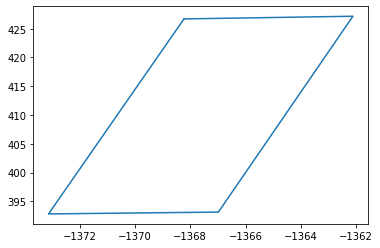

In [15]:
from shapely import geometry

b = Building(data1.iloc[500]["geometry.coordinates"][0], data1.iloc[500]["properties.height"])
x, y = b.xy_polygon.boundary.xy
plt.plot(x, y)

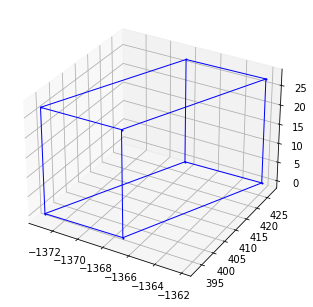

In [16]:
r = Renderer(backend='matplotlib')
for p in b.wall_polygons:
    r.add((p,'b',1),normal_length=0)
r.show()

In [17]:
from tqdm import tqdm
buildings = []

for i in tqdm(range(len(data1))):
    for coords in data1.iloc[i]["geometry.coordinates"]:
        try:
            buildings.append(Building(coords, data1.iloc[i]["properties.height"]))
        except:
            print(f"Skipping building {i}")

  1%|▍                                                                              | 49/8644 [00:00<00:39, 215.12it/s]

Skipping building 26
Skipping building 26
Skipping building 27
Skipping building 27
Skipping building 27
Skipping building 28
Skipping building 28
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 53
Skipping building 53
Skipping building 53
Skipping building 53


100%|█████████████████████████████████████████████████████████████████████████████| 8644/8644 [00:16<00:00, 510.73it/s]

Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8170
Skipping building 8170
Skipping building 8170
Skipping bu

In [18]:
class FSS_Channels:
  # channels start at 0, so a channel plan with 8 channels is from 0 to 7

  band_width = 240e6 # 240MHz

  # 10.7-12.7 GHz frequency range
  range_start = 10.7e9 # 10.7GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 8

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # FSS channel spacing should be 10MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel_start = int((0.5 + channel) * FSS_Channels.space_between_channels + channel * FSS_Channels.band_width)
    channel_end = channel_start + FSS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [19]:
class BS_Channels:
  # channels start at 1, so a channel plan with 5 channels is from 1 to 5

  band_width = 100e6 # 100MHz

  # 12.2-12.7 GHz frequency range
  range_start = 12.2e9 # 12.2GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 5

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # BS channel spacing should be 0MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel -= 1
    
    channel_start = int((0.5 + channel) * BS_Channels.space_between_channels + channel * BS_Channels.band_width)
    channel_end = channel_start + BS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [20]:
def path_loss_UMi(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##UMi
##LOS,SF=4:

##(10m<=d_2D)<=D_BP:
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y-BS_Y)**2)+((4.5-10)**2))
    hBs=10
    fc=12
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL1umi=32.4+21*math.log10(d_3D)+20*math.log10(fc)
    
##(D_BP<=d_2D)<=5000m:
    hBs=10
    hUT=4.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL2umi=32.4+40*math.log10(d_3D)+20*math.log10(fc)-9.5*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMiLOS=PL1umi
    elif D_BP<=d_2D and  d_2D<=5000:
        PLUMiLOS= PL2umi  
    else:
        PLUMiLOS=1

##NLOS,SF=7.82:
    PL1umiNLOS= 35.3*math.log10(d_3D)+22.4+21.3*math.log10(fc)-0.3*(hUT-1.5)
    PLUMiNLOS= max(PLUMiLOS,PL1umiNLOS)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, 10), Point(FSS_X, FSS_Y, 4.5))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMi = PLUMiNLOS
                    line_of_sight = False
                else:
                    path_loss_UMi = PLUMiLOS
#                     line_of_sight = True
    
 # intersection(line, polygon): [Intersection], None
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMi = PLUMiNLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMi = PLUMiLOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
    
# #Loss Probability:
#     if d_2D>18:
#         PrLosUmi=(18/d_2D)+math.exp((-(d_2D/36))*(1-(18/d_2D)))     
#     else:
#         PrLosUmi=1 ##d_2d<=18     
#     if PrLosUmi > random.random():
#         path_loss_UMi = PLUMiLOS   
#     else:
#         path_loss_UMi = PLUMiNLOS   
##path_loss 
#     path_loss_UMi= PL2umi*PrLosUmi+PL1umiNLOS*(1-PrLosUmi)
    
    return path_loss_UMi, d_2D, line_of_sight

In [21]:
def path_loss_UMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4:
##(10m<=d_2D)<=D_BP:
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+(FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2)
    hBs=25
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL3uma=28.0+22*math.log10(d_3D)+20*math.log10(fc)
    
##(D_BP<=d_2D) <=5000m:
    hUT=1.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL4uma=28.0+40*math.log10(d_3D)+20*math.log10(fc)-9*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMALOS=PL3uma
    elif D_BP<=d_2D and d_2D<=5000:
         PLUMALOS= PL4uma  
    else:
        PLUMALOS=1
        
##NLOS,SF=6:
    PL1NLOSuma=13.54+39.08*math.log10(d_3D)+20*math.log10(fc)-0.6*(hUT-1.5)
    PLUMANLOS=max(PLUMALOS,PL1NLOSuma)
    
    line_of_sight = True

##NLOS,SF=7.8 (optional)
##PL_Optional=32.4+20*math.log(fc)+30*math.log(d_3D)


##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMa = PLUMANLOS
                    line_of_sight = False
                else:
                    path_loss_UMa = PLUMALOS
#                     line_of_sight = True
                
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMa = PLUMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMa = PLUMALOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False


##Loss Probability:
#     if d_2D >18:
#         if hUT<=13:
#             ChUT=0
#         elif 13<hUT and hUT<=23:
#             ChUT=((hUT-13)/10)**1.5  
#         PrLOSUma=((18/d_2D)+math.exp((-(d_2D/63))*(1-(18/d_2D))))*(1+ChUT*(5/4)*((d_2D/100)**3)*math.exp(-(d_2D/150)))
#     else:##18m<d_2D:
#         PrLOSUma=1
        
#     if PrLOSUma > random.random():
#         path_loss_UMa = PLUMALOS
    
#     else:
#         path_loss_UMa = PLUMANLOS
    
##Path Loss
#     path_loss_UMa= PL4uma*PrLOSUma+PL1NLOSuma*(1-PrLOSUma)
    return path_loss_UMa, d_2D, line_of_sight

In [22]:
def path_loss_RMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4(PL1),SF=6(PL2)
##10m<=d_2D<=d_BP: 
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2))
    hBs=35
    d_3D= math.sqrt(hBs**2+d_2D**2)
    PL1rma=20*math.log10((40*math.pi*d_3D*fc)/3)+ min(0.03*h**1.72,10)*math.log10(d_3D)-min(0.044*h**1.72,14.77)+0.002*math.log10(h)*d_3D
    
##d_BP<=d_2D<=10km:
    hUT=1.5
    c=3e8
    d_BP= (2*math.pi*hBs*hUT*12e9)/c
    PL2rma= PL1rma*(d_BP)+40*math.log10(d_3D/d_BP)

    if 10<=d_2D and d_2D <=d_BP:
        PLRMALOS=PL1rma
    elif d_BP<=d_2D and d_2D <=10000:
        PLRMALOS= PL2rma  
    else:
        PLRMALOS=1

##NLOS,SF=8:
    W=20
    h=5
    PL1NLOSrma= 161.04-7.11*math.log10(W)+7.5*math.log10(h)-(24.37-3.7*(h/hBs)**2)*math.log10(hBs)+(43.42-3.1*math.log10(hBs))*(math.log10(d_3D)-3)+20*math.log10(fc)-(3.2*(math.log10(11.75*hUT))**2-4.97)
    PLRMANLOS=max(PLRMALOS,PL1NLOSrma)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_RMa = PLRMANLOS
                    line_of_sight = False
                else:
                    path_loss_RMa = PLRMALOS
                    # line_of_sight = True
   
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_RMa = PLRMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_RMa = PLRMALOS
                # line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
                
    

# ##Loss Probability:
#     if d_2D>10:
#         PrLOSrma=math.exp(-((d_2D-10)/1000))
        
# ## 10m<d_2D:
#     else:
#         PrLOSrma=1
        
#     if PrLOSrma > random.random():
#         path_loss_RMa= PLRMALOS
    
#     else:
#         path_loss_RMa = PLRMANLOS

##PathLoss:
#     path_loss_RMa=PL2rma*PrLOSrma+PL1NLOSrma*(1-PrLOSrma)
    return path_loss_RMa, d_2D,  line_of_sight

In [23]:
def Interface_UMi_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMi,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        # theta_tilt, phi_scan = max_gain_5g_parameters(theta, phi)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, (10-4.5)

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
#         print("Angle between interference axis and FSS main lobe:", fss_phi_difference)
        if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)

#         G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)

        TXPower= 8
#         LBuildingLoss=1
        interface1=TXPower+ 0-pathloss_UMi- LBodyLoss + G_Rx_5G 
        return interface1,pathloss_UMi

In [24]:
def Interface_UMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)

#         G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= 8
#         LBuildingLoss=1
        interface2=TXPower+ 0-pathloss_UMa- LBodyLoss + G_Rx_5G
        return interface2,pathloss_UMa
    

In [25]:
def Interface_RMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_RMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        # if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        if output: print("fss_phi_difference:", fss_phi_difference)

#         G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= 8
#         LBuildingLoss=1
        interface3=TXPower+ 0-pathloss_RMa-LBodyLoss + G_Rx_5G
        return interface3,pathloss_RMa

In [26]:
k = 1.38064852*10**(-23)
T=200
B=240e6
Noise = 10*math.log10(k*T*B)
Noise_W = 10 ** (Noise / 10)
print('Noise:', Noise)
print('Noise in Watts:', Noise_W)

Noise: -121.78675630934148
Noise in Watts: 6.627112895999999e-13


In [27]:
bs_ue_max_radius = 1000
bs_ue_min_radius= 1
base_station_count=33

# fss1 = BS(radius, max_height=1.5, carr_freq=12e9, interference_type=None)
x,y,z = 0,0,4.5

FSS_phi = {
    'UMi': 8,
    'UMa': 48,
    'RMa': 5
}

exclusion_zones = [500, 1000, 2000, 3000, 4000]
        
def simulate(output=True):
    FSS_X=np.array([])
    FSS_Y=np.array([])
    FSS_Z=np.array([])
    FSS_CHANNELS = []
    for i in range (1):
        FSS_X = np.append(FSS_X, x)
        FSS_Y = np.append(FSS_Y, y)
        FSS_Z = np.append(FSS_Z, 4.5)
        # 0 means not in use, 1 means in use
        channel_status = [random.randint(0, 1) for i in range(FSS_Channels.channel_count)]
        channels_used = np.array([i for i in range(FSS_Channels.channel_count) if channel_status[i] == 1])
        FSS_CHANNELS.append(channels_used)
        if output: print("FSS Co-ordinates=" +str (x)+ "," + str(y)+ "," + str(z) + ", channel: " + str(channels_used))
    if output: print(FSS_X, FSS_Y, FSS_Z, FSS_CHANNELS)

    # Create base stations
    BS_X=np.array([])
    BS_Y=np.array([])
    BS_Z=np.array([])
    
    # Randomly select base stations 
    # base_station_indexes = random.sample(range(len(data_within_zone)), base_station_count)

    # for i in base_station_indexes:
    for i in range(base_station_count):
        lat_BS, lon_BS = data_within_zone.iloc[i]['latitude'], data_within_zone.iloc[i]['longitude']
#         bs1 = BS(radius, max_height=35, carr_freq=12e9, interference_type=None)
        x_BS = R * math.cos(math.radians(lat_BS)) * math.cos(math.radians(lon_BS))
        y_BS = R * math.cos(math.radians(lat_BS)) * math.sin(math.radians(lon_BS))
#         z_BS = R * math.sin(math.radians(lat_BS))

        BS_X = np.append(BS_X, x_BS - x_FSS)
        BS_Y = np.append(BS_Y, y_BS - y_FSS)
        BS_Z = np.append(BS_Z, 0)
        if output: print("Bs Co-ordinates=" +str (x_BS)+ "," + str(y_BS)+ "," + str(z_BS))
    
    if output: print(BS_X,BS_Y,BS_Z)

    # Create user equipment
    UE_X=np.array([])
    UE_Y=np.array([])
    UE_Z=np.array([])
    UE_CHANNEL=np.array([])
    for p in range (len(BS_X)):
        for i in range(3):
    # number of split regions
    # i is the sector number
            for j in range(10):
      # number of UEs per region
      # j is the number of the UE in one sector
                bs_x, bs_y, bs_z = BS_X[p], BS_Y[p],BS_Z[p]
                theta_bs_ue = random.uniform(120 * i, 120 * (i+1))
                # 0-120, 120-240, 240-360
                radius_bs_ue = random.uniform(bs_ue_min_radius, bs_ue_max_radius)

                x1 = bs_x + radius_bs_ue * math.cos(math.radians(theta_bs_ue))
                y1 = bs_y + radius_bs_ue * math.sin(math.radians(theta_bs_ue))

                UE_X = np.append(UE_X, x1)
                UE_Y = np.append(UE_Y, y1)
                UE_Z = np.append(UE_Z, 1.5)

                maximum_UEs_per_channel = 4

                if j > maximum_UEs_per_channel * BS_Channels.channel_count:
                    raise Exception(f"BS cannot support {j} UEs")

                count = {i: 0 for i in range(1, BS_Channels.channel_count + 1)}

                channel = random.randint(1, BS_Channels.channel_count)

                while count[channel] >= maximum_UEs_per_channel:
                    channel = random.randint(1, BS_Channels.channel_count)

                count[channel] += 1

                UE_CHANNEL = np.append(UE_CHANNEL, channel)

                if output: print("UE Co-ordinates=" +str (x1)+ "," + str(y1)+ "," + str(z1) + ", channel: " + str(channel))
            if output: print(UE_X,UE_Y,UE_Z)
        
    pathloss_UMa=np.empty([0])
    pathloss_UMi=np.empty([0])
    pathloss_RMa=np.empty([0])
    distance_UMa=np.empty([0])
    distance_UMi=np.empty([0])
    distance_RMa=np.empty([0])
    line_of_sight=np.empty([0])
    for i in range(len(BS_X)):
        for j in range (len(FSS_X)):
            pathlossumi,distance,los_single = path_loss_UMi(BS_X[i],BS_Y[i],10,FSS_X[j],FSS_Y[j],4.5)
            pathlossuma,distance,los_single = path_loss_UMa(BS_X[i],BS_Y[i],25,FSS_X[j],FSS_Y[j],FSS_Z[j])
            pathlossrma,distance,los_single = path_loss_RMa(BS_X[i],BS_Y[i],35,FSS_X[j],FSS_Y[j],FSS_Z[j])
            if output: print("pathloss umi:", pathlossumi, "uma:", pathlossuma, "rma:", pathlossrma, "for distance", distance)
            
            pathloss_UMa=np.append(pathloss_UMa,pathlossuma)
            distance_UMa=np.append(distance_UMa,distance)
            pathloss_UMi=np.append(pathloss_UMi,pathlossumi)
            distance_UMi=np.append(distance_UMi,distance)
            pathloss_RMa=np.append(pathloss_RMa,pathlossrma)
            distance_RMa=np.append(distance_RMa,distance)
            
            line_of_sight=np.append(line_of_sight,los_single)
            

    if output: print(pathloss_UMi,distance_UMi)
    if output: print(pathloss_UMa,distance_UMa)
    if output: print(pathloss_RMa,distance_RMa)

    interface_UMi_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    interface_UMa_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    interface_RMa_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    for i in range(len(BS_X)):
        interface_UMi_BS=np.empty([0])
        interface_UMa_BS=np.empty([0])
        interface_RMa_BS=np.empty([0])
        for j in range(len(FSS_X)):
            print(f"BS {i}, FSS {j}, pathloss {pathloss_UMi[i*len(FSS_X)+j]}")
            for k in random.sample(range(len(UE_X)),30):
                # channel check
                # if UE is using channel 1, the start is 12.2GHz and the end is 12.3GHz
                bs_channel_start, bs_channel_end = BS_Channels.getChannelRange(UE_CHANNEL[k])
                bs_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))

                interference_found = False

                for fss_channel in FSS_CHANNELS[j]:
                    # if fss_channel >= 6:
                    fss_channel_start, fss_channel_end = FSS_Channels.getChannelRange(fss_channel)
                    fss_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))
                    
                    bs_set = set(bs_channel_range)
                    if len(bs_set.intersection(fss_channel_range)):
                        interference_found = True

                if not interference_found:
#                     interface_UMi_W=np.append(interface_UMi_W,0)
#                     interface_UMa_W=np.append(interface_UMa_W,0)
#                     interface_RMa_W=np.append(interface_RMa_W,0)
                    continue

                for interference_type in ["UMi", "UMa", "RMa"]:
                    if interference_type == "UMi":
                        BS_Z = np.array([10 for i in range(len(BS_X))])
                    elif interference_type == "UMa":
                        BS_Z = np.array([25 for i in range(len(BS_X))])
                    elif interference_type == "RMa":
                        BS_Z = np.array([35 for i in range(len(BS_X))])
                    # bs_ue_x, bs_ue_y, bs_ue_z = BS_X-UE_X, BS_Y-UE_Y, BS_Z-UE_Z
                    bs_ue_x, bs_ue_y, bs_ue_z = UE_X[k]-BS_X[i], UE_Y[k]-BS_Y[i], UE_Z[k]-BS_Z[i]

                    theta_bs_ue = np.arctan(bs_ue_y/bs_ue_x)
                    phi_bs_ue = np.sqrt(bs_ue_x**2 + bs_ue_y**2) / bs_ue_z

                    theta_bs_ue = np.degrees(theta_bs_ue) % 360
                    phi_bs_ue = np.degrees(phi_bs_ue) % 360
                    if output: print("theta_bs_ue:", theta_bs_ue, "phi_bs_ue:", phi_bs_ue)

#                     theta_tilt, phi_scan = max_gain_5g_parameters(theta_bs_ue, phi_bs_ue)
                    

                    if interference_type == "UMi":
                        interfaceumi,pathloss_UMi_x= Interface_UMi_1(BS_X[i],BS_Y[i],10,FSS_X[j],FSS_Y[j],4.5,FSS_phi['UMi'],pathloss_UMi[i*len(FSS_X)+j])
                        print("UE:", k, "/ interference umi:", interfaceumi, "/ pathloss:", pathlossumi)
                        interface_UMi_BS=np.append(interface_UMi_BS,interfaceumi)
#                     elif interference_type == "UMa":
#                         interfaceuma,pathloss_UMa_x= Interface_UMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['UMa'],pathloss_UMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         print("UE:", k, "/ interference uma:", interfaceuma, "/ pathloss:", pathlossuma)
#                         interface_UMa_BS=np.append(interface_UMa_BS,interfaceuma)
#                     elif interference_type == "RMa":
#                         interfacerma,pathloss_RMa_x= Interface_RMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['RMa'],pathloss_RMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         print("UE:", k, "/ interference rma:", interfacerma, "/ pathloss:", pathlossrma)
#                         interface_RMa_BS=np.append(interface_RMa_BS,interfacerma)
        
        for exclusion_zone in exclusion_zones:
            if distance_UMi[i*len(FSS_X)+j] > exclusion_zone:
                interface_UMi_W[exclusion_zone] = np.append(interface_UMi_W[exclusion_zone], np.sum(10 ** (interface_UMi_BS / 10))/30)
            if distance_UMa[i*len(FSS_X)+j] > exclusion_zone:
                interface_UMa_W[exclusion_zone] = np.append(interface_UMa_W[exclusion_zone], np.sum(10 ** (interface_UMa_BS / 10))/30)
            if distance_RMa[i*len(FSS_X)+j] > exclusion_zone:
                interface_RMa_W[exclusion_zone] = np.append(interface_RMa_W[exclusion_zone], np.sum(10 ** (interface_RMa_BS / 10))/30)
              
    if output: print(interface_UMi_W,pathloss_UMi)
    if output: print(interface_UMa_W,pathloss_UMa)
    if output: print(interface_RMa_W,pathloss_RMa)

    # I_N_UMi = np.array([interfaceumi-Noise for interfaceumi in interface_UMi])
    I_N_UMi, I_N_UMa, I_N_RMa = dict(), dict(), dict()
    for exclusion_zone in exclusion_zones:
        I_N_UMi[exclusion_zone] = interface_UMi_W[exclusion_zone] / Noise_W
    if output: print('I/N UMi:', I_N_UMi) 
    for exclusion_zone in exclusion_zones:
        I_N_UMa[exclusion_zone] = interface_UMa_W[exclusion_zone] / Noise_W  
    if output: print('I/N UMa:', I_N_UMa)
    for exclusion_zone in exclusion_zones:
        I_N_RMa[exclusion_zone] = interface_RMa_W[exclusion_zone] / Noise_W
    if output: print('I/N RMa:', I_N_RMa)  

    return distance_RMa, I_N_RMa, distance_UMa, I_N_UMa, distance_UMi, I_N_UMi, line_of_sight
        

In [28]:
# Prototype functions to calculate antenna gain of 5G base station and FSS earth station

import math, cmath
from scipy import optimize

# gain is in dBi

# 3GPP TR 38.901
# https://www.etsi.org/deliver/etsi_tr/138900_138999/138901/14.00.00_60/tr_138901v140000p.pdf
antenna_gain_max = 8

# values recommended by Dr. Zoheb
rows = 16  # Nv
cols = 16  # Nh
hspace = 0.5  # dh/λ
vspace = 0.5  # dv/λ

# constant values based on ECC Rep 281
phi_3db = 80  # degrees
theta_3db = 65  # degrees
front_to_back_ratio = 30  # dB
side_lobe_level_limit = 30  # dB

# antenna horizontal pattern
def gain_antenna_element_horizontal(phi) -> float:
    return -min(
                12 * (phi / phi_3db)**2, 
                front_to_back_ratio
            )

# antenna vertical pattern
def gain_antenna_element_vertical(theta) -> float:
    return -min(
                12 * ((theta - 90) / theta_3db)**2,
                side_lobe_level_limit
            )

# antenna element gain of elevation and azimuth plane
def gain_antenna_element(theta, phi) -> float:
    return antenna_gain_max - \
            min(
                -(gain_antenna_element_horizontal(phi) + gain_antenna_element_vertical(theta)), 
                front_to_back_ratio
            )

def superposition(n, m, theta, phi, hspace, vspace) -> complex:
    return cmath.exp(complex(0, 2 * math.pi * \
                (
                    (n-1) * vspace * math.cos(math.radians(theta)) + \
                    (m-1) * hspace * math.sin(math.radians(theta)) * math.sin(math.radians(phi))
                )
            ))

def weighting(n, m, theta_tilt, phi_scan, hspace, vspace) -> complex:
    return cmath.exp(complex(0, -2 * math.pi * \
                (
                    (n-1) * vspace * math.sin(math.radians(theta_tilt)) + \
                    (m-1) * hspace * math.cos(math.radians(theta_tilt)) * math.sin(math.radians(phi_scan))
                )
            )) / cmath.sqrt(rows * cols)

# returns theta_tilt and phi_scan which yield maximum antenna gain given theta and phi
# def max_gain_5g_parameters(theta, phi, coarse=True, rounding_precision=0) -> tuple:
#     if coarse:
#         theta = round(theta, rounding_precision)
#         phi = round(phi, rounding_precision)
#     if (theta, phi) in saved_tp:
#         # print(f'match found for ({theta}, {phi}), using that')
#         return saved_tp.get((theta, phi))
    
    
    
#     # return max_parameters
#     # scipy's optimization can only find the minimum, so we pass a function which returns the negative of the weighting function
#     result = optimize.brute(
#         lambda x: -beam_pattern_5g(theta, phi, x[0], x[1]),  # x[0] = theta_tilt, x[1] = phi_scan
#         # theta_tilt is between -90 and 90 degrees, phi_scan is between -180 and 180 degrees
#         ranges = [(-90, 90), (-180, 180)]
        
#     )
#     saved_tp[(theta, phi)] = tuple(x for x in result)
    
#     return saved_tp[(theta, phi)]


# a_A, the directional pattern from beam forming with an array of elements
# def beam_pattern_5g(theta, phi, theta_tilt, phi_scan) -> float:
#     summation = 0
#     # weighting multiplied by the superposition vector
#     for n in range(1, rows+1):
#         for m in range(1, cols+1):
#             # print(f"{theta_tilt}, {phi_scan}, {abs(weighting(n, m, theta_tilt, phi_scan, hspace, vspace))}")
#             summation += weighting(n, m, theta_tilt, phi_scan, hspace, vspace) * superposition(n, m, theta, phi, hspace, vspace)

#     return abs(summation)**2

# # antenna gain of 5G base station (represented by a single beam i)
# # def gain_5g(theta, phi, theta_tilt, phi_scan) -> float:
# #     beam_pattern = beam_pattern_5g(theta, phi, theta_tilt, phi_scan)

# #     return gain_antenna_element(theta, phi) + \
# #            10 * math.log10(beam_pattern)

# # space refers to D/λ
# def get_phi_min(space) -> float:
#     # Rec. ITU-R S.465-6
#     if space >= 50:
#         return max(1.0, 100 * (1 / space))
#     else:
#         return max(2.0, 114 * (space ** -1.09))

# receiving antenna gain of FSS earth station
# phi is an angle between base station antenna direction and FSS ES antenna's main axis (elevation angle)
# def gain_fss_s1428(phi, phi_min) -> float:

#     if 0 < phi < phi_min:
#         return 32 - 25 * math.log10(phi_min)
#     elif phi_min <= phi < 48:
#         return 32 - 25 * math.log10(phi)
#     elif 48 <= phi <= 180:
#         return -10

#     # This function is only defined where phi is within (0, 180]
#     raise ValueError(f'Angle phi must be within the interval (0, 180] degrees, was {phi} degrees instead')

# co-polarized components only
# https://www.etsi.org/deliver/etsi_en/303900_303999/303981/01.02.01_60/en_303981v010201p.pdf
def gain_fss_wbes_b(phi) -> float:
    if 0 <= phi < 6:
        return 20
    elif 6 <= phi < 48:
        return 40 - 25 * math.log10(phi)
    elif 48 <= phi <= 180:
        return -2
    elif 180 <= phi <= 360:
        return gain_fss_wbes_b(360 - phi)

    # This function is only defined where phi is within [6, 180]
    raise ValueError(f'Angle phi must be within the interval [6, 180] degrees, was {phi} degrees instead')
    

In [29]:
from tqdm import tqdm
distance_RMa, distance_UMa, distance_UMi, line_of_sight = [np.empty([0]) for x in range(4)]
I_N_RMa_W, I_N_RMa_noAverage, I_N_UMa_W, I_N_UMa_noAverage, I_N_UMi_W, I_N_UMi_noAverage = [{exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones} for x in range(6)]

simulation_count = 10
for i in tqdm(range(simulation_count)):
    distance_RMa_single, I_N_RMa_single_W, distance_UMa_single, I_N_UMa_single_W, distance_UMi_single, I_N_UMi_single_W, line_of_sight_single = simulate(output=False)
    distance_RMa = np.append(distance_RMa, distance_RMa_single)
    distance_UMa = np.append(distance_UMa, distance_UMa_single)
    distance_UMi = np.append(distance_UMi, distance_UMi_single)

    I_N_groups = [
      (I_N_RMa_W, I_N_RMa_noAverage, I_N_RMa_single_W),
      (I_N_UMa_W, I_N_UMa_noAverage, I_N_UMa_single_W),
      (I_N_UMi_W, I_N_UMi_noAverage, I_N_UMi_single_W)
   ]
    for I_N_W, I_N_noAverage, I_N_single_W in I_N_groups:
        for exclusion_zone in exclusion_zones:
            I_N_W[exclusion_zone] = np.append(I_N_W[exclusion_zone], I_N_single_W[exclusion_zone])
            I_N_noAverage[exclusion_zone] = np.append(I_N_noAverage[exclusion_zone], 10 * np.log10(I_N_single_W[exclusion_zone]))
    
    line_of_sight = np.append(line_of_sight, line_of_sight_single)
    
for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
    arr[arr == -np.inf]=0

# for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
#     for exclusion_zone in exclusion_zones:
#         arr[exclusion_zone][arr[exclusion_zone] == -np.inf]=0
    
I_N_RMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_RMa_W[exclusion_zone])) for exclusion_zone in I_N_RMa_W}
I_N_UMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMa_W[exclusion_zone])) for exclusion_zone in I_N_UMa_W}
I_N_UMi = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMi_W[exclusion_zone])) for exclusion_zone in I_N_UMi_W}

pairs = {
  'RMa': (np.average(distance_RMa), I_N_RMa),
  'UMa': (np.average(distance_UMa), I_N_UMa),
  'UMi': (np.average(distance_UMi), I_N_UMi)
}

pairs_noAverage = {
  'RMa': (distance_RMa, I_N_RMa_noAverage),
  'UMa': (distance_UMa, I_N_UMa_noAverage),
  'UMi': (distance_UMi, I_N_UMi_noAverage)
}


 39%|██████████████████████████████▎                                              | 3224/8177 [00:07<00:17, 286.96it/s]


 71%|██████████████████████████████████████████████████████▊                      | 5821/8177 [00:15<00:07, 320.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:22<00:00, 360.55it/s]

  2%|█▎                                                                            | 140/8177 [00:00<00:44, 179.16it/s]


 38%|████████████████████████████▉                                                | 3067/8177 [00:08<00:13, 376.68it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6907/8177 [00:16<00:02, 529.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 434.79it/s]

 28%|█████████████████████▏                                                       | 2253/8177 [00:05<00:14, 417.17it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6020/8177 [00:12<00:03, 542.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.46it/s]

 18%|█████████████▉                                                               | 1475/8177 [00:03<00:11, 566.40it/s]


 64%|█████████████████████████████████████████████████▍                           | 5255/8177 [00:11<00:05, 529.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.96it/s]

  7%|█████▌                                                                        | 577/8177 [00:01<00:22, 339.19it/s]


 55%|██████████████████████████████████████████                                   | 4461/8177 [00:09<00:06, 572.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.71it/s]

  1%|▌                                                                              | 56/8177 [00:00<00:31, 254.16it/s]


 45%|██████████████████████████████████▌                                          | 3670/8177 [00:08<00:07, 570.65it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7608/8177 [00:15<00:01, 501.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.65it/s]

 35%|███████████████████████████▏                                                 | 2884/8177 [00:06<00:11, 474.72it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6575/8177 [00:14<00:03, 521.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 457.15it/s]

 22%|█████████████████                                                            | 1807/8177 [00:04<00:12, 525.05it/s]


 66%|██████████████████████████████████████████████████▋                          | 5379/8177 [00:11<00:05, 475.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 461.71it/s]

  7%|█████▌                                                                        | 589/8177 [00:01<00:25, 297.27it/s]


 53%|████████████████████████████████████████▍                                    | 4300/8177 [00:09<00:07, 541.63it/s]


 99%|████████████████████████████████████████████████████████████████████████████▎| 8099/8177 [00:17<00:00, 493.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 464.51it/s]

 41%|███████████████████████████████▌                                             | 3357/8177 [00:07<00:11, 414.44it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7181/8177 [00:15<00:02, 426.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 469.62it/s]

 30%|██████████████████████▉                                                      | 2438/8177 [00:05<00:14, 385.72it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6147/8177 [00:13<00:03, 536.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.67it/s]

 19%|██████████████▊                                                              | 1570/8177 [00:03<00:11, 567.29it/s]


 65%|█████████████████████████████████████████████████▉                           | 5307/8177 [00:11<00:05, 501.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.80it/s]

  6%|█████                                                                         | 525/8177 [00:01<00:22, 342.18it/s]


 53%|████████████████████████████████████████▊                                    | 4330/8177 [00:09<00:06, 563.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.50it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 42%|████████████████████████████████▌                                            | 3457/8177 [00:07<00:10, 460.66it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7228/8177 [00:15<00:02, 448.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.78it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:05<00:13, 445.46it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6026/8177 [00:13<00:03, 545.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 458.20it/s]

 16%|████████████▌                                                                | 1332/8177 [00:03<00:12, 532.63it/s]


 61%|███████████████████████████████████████████████▎                             | 5022/8177 [00:10<00:06, 515.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.25it/s]

  5%|███▌                                                                          | 379/8177 [00:01<00:19, 395.78it/s]


 50%|██████████████████████████████████████▎                                      | 4062/8177 [00:09<00:07, 554.87it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7875/8177 [00:16<00:00, 438.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.51it/s]

 39%|█████████████████████████████▉                                               | 3183/8177 [00:07<00:13, 382.97it/s]


 86%|██████████████████████████████████████████████████████████████████▎          | 7037/8177 [00:14<00:02, 402.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.52it/s]

 28%|█████████████████████▍                                                       | 2276/8177 [00:05<00:14, 413.98it/s]


 73%|███████████████████████████████████████████████████████▉                     | 5945/8177 [00:12<00:04, 501.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 462.89it/s]

 14%|██████████▋                                                                  | 1141/8177 [00:02<00:16, 430.26it/s]


 59%|█████████████████████████████████████████████                                | 4785/8177 [00:10<00:07, 479.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 442.90it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 40%|██████████████████████████████▉                                              | 3287/8177 [00:07<00:13, 352.46it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 7003/8177 [00:15<00:02, 469.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 454.93it/s]

 29%|██████████████████████▎                                                      | 2376/8177 [00:05<00:17, 336.62it/s]


 76%|██████████████████████████████████████████████████████████▊                  | 6249/8177 [00:12<00:03, 574.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.32it/s]

 21%|████████████████▏                                                            | 1722/8177 [00:03<00:12, 530.37it/s]


 67%|███████████████████████████████████████████████████▊                         | 5503/8177 [00:11<00:05, 533.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.35it/s]

 11%|████████▎                                                                     | 873/8177 [00:02<00:15, 478.48it/s]


 59%|█████████████████████████████████████████████▌                               | 4835/8177 [00:10<00:06, 524.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.67it/s]

  4%|███▏                                                                          | 340/8177 [00:01<00:19, 401.33it/s]


 50%|██████████████████████████████████████▍                                      | 4086/8177 [00:08<00:07, 550.28it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7934/8177 [00:16<00:00, 470.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.90it/s]

 39%|██████████████████████████████▏                                              | 3205/8177 [00:07<00:13, 381.52it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7095/8177 [00:14<00:02, 388.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.88it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:05<00:12, 443.30it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6320/8177 [00:13<00:03, 587.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.22it/s]

 21%|████████████████                                                             | 1711/8177 [00:03<00:12, 531.15it/s]


 67%|███████████████████████████████████████████████████▏                         | 5442/8177 [00:11<00:05, 534.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 469.75it/s]

  8%|██████▎                                                                       | 666/8177 [00:01<00:18, 395.51it/s]


 54%|█████████████████████████████████████████▊                                   | 4435/8177 [00:09<00:07, 529.86it/s]


 94%|████████████████████████████████████████████████████████████████████████▋    | 7724/8177 [00:17<00:01, 297.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 436.97it/s]

 37%|████████████████████████████▍                                                | 3022/8177 [00:07<00:14, 365.54it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6756/8177 [00:14<00:02, 523.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.76it/s]

 25%|███████████████████▌                                                         | 2079/8177 [00:04<00:13, 467.14it/s]


 70%|█████████████████████████████████████████████████████▌                       | 5685/8177 [00:12<00:04, 505.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 460.78it/s]

 11%|████████▎                                                                     | 865/8177 [00:02<00:16, 442.63it/s]


 57%|███████████████████████████████████████████▊                                 | 4658/8177 [00:10<00:06, 547.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 461.48it/s]

  1%|▌                                                                              | 54/8177 [00:00<00:35, 226.26it/s]


 42%|████████████████████████████████▌                                            | 3457/8177 [00:08<00:10, 447.41it/s]


 88%|███████████████████████████████████████████████████████████████████▊         | 7206/8177 [00:15<00:02, 459.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 457.78it/s]

 31%|████████████████████████▏                                                    | 2571/8177 [00:05<00:11, 471.79it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6439/8177 [00:13<00:03, 548.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.31it/s]

 23%|██████████████████                                                           | 1917/8177 [00:04<00:12, 502.54it/s]


 71%|██████████████████████████████████████████████████████▎                      | 5765/8177 [00:12<00:04, 519.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.91it/s]

 14%|██████████▉                                                                  | 1163/8177 [00:02<00:15, 467.27it/s]


 61%|███████████████████████████████████████████████▎                             | 5020/8177 [00:10<00:06, 524.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.06it/s]

  5%|███▋                                                                          | 381/8177 [00:01<00:19, 397.55it/s]


 51%|███████████████████████████████████████▋                                     | 4211/8177 [00:09<00:07, 520.87it/s]


 99%|████████████████████████████████████████████████████████████████████████████▎| 8100/8177 [00:16<00:00, 511.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.35it/s]

 42%|████████████████████████████████                                             | 3410/8177 [00:07<00:11, 423.75it/s]


 90%|█████████████████████████████████████████████████████████████████████▎       | 7361/8177 [00:15<00:01, 577.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.12it/s]

 34%|██████████████████████████                                                   | 2773/8177 [00:06<00:09, 546.67it/s]


 81%|██████████████████████████████████████████████████████████████               | 6595/8177 [00:13<00:03, 448.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.38it/s]

 25%|███████████████████▏                                                         | 2031/8177 [00:04<00:12, 491.99it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5761/8177 [00:12<00:04, 537.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.49it/s]

 14%|██████████▊                                                                  | 1154/8177 [00:02<00:15, 440.44it/s]


 60%|██████████████████████████████████████████████▏                              | 4902/8177 [00:10<00:06, 505.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.99it/s]

  4%|███▎                                                                          | 346/8177 [00:01<00:19, 406.57it/s]


 50%|██████████████████████████████████████▎                                      | 4071/8177 [00:08<00:07, 532.25it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7937/8177 [00:16<00:00, 469.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.24it/s]

 40%|██████████████████████████████▍                                              | 3236/8177 [00:07<00:15, 320.67it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7087/8177 [00:15<00:02, 377.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.49it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:05<00:12, 447.29it/s]


 77%|███████████████████████████████████████████████████████████▋                 | 6333/8177 [00:13<00:03, 561.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.10it/s]

 20%|███████████████▍                                                             | 1644/8177 [00:03<00:12, 506.76it/s]


 67%|███████████████████████████████████████████████████▏                         | 5442/8177 [00:11<00:05, 530.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.62it/s]

  9%|███████                                                                       | 741/8177 [00:02<00:15, 467.63it/s]


 55%|██████████████████████████████████████████▌                                  | 4520/8177 [00:09<00:06, 572.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.13it/s]

  0%|▎                                                                              | 29/8177 [00:00<00:33, 244.20it/s]


 42%|████████████████████████████████                                             | 3405/8177 [00:08<00:10, 437.90it/s]


 88%|███████████████████████████████████████████████████████████████████▉         | 7213/8177 [00:15<00:02, 458.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.85it/s]

 31%|████████████████████████                                                     | 2561/8177 [00:05<00:12, 450.29it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6327/8177 [00:13<00:03, 572.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.67it/s]

 20%|███████████████▌                                                             | 1658/8177 [00:03<00:12, 526.67it/s]


 66%|██████████████████████████████████████████████████▌                          | 5375/8177 [00:11<00:05, 495.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.18it/s]

  8%|██████▏                                                                       | 645/8177 [00:01<00:20, 361.74it/s]


 54%|█████████████████████████████████████████▊                                   | 4434/8177 [00:09<00:06, 559.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.21it/s]



 42%|████████████████████████████████▏                                            | 3421/8177 [00:07<00:10, 449.73it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7416/8177 [00:15<00:01, 618.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.28it/s]

 35%|██████████████████████████▉                                                  | 2867/8177 [00:06<00:10, 489.20it/s]


 82%|███████████████████████████████████████████████████████████████▍             | 6734/8177 [00:13<00:02, 527.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.27it/s]

 27%|████████████████████▌                                                        | 2182/8177 [00:04<00:13, 428.67it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5965/8177 [00:12<00:04, 528.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 469.94it/s]

 16%|████████████▋                                                                | 1343/8177 [00:03<00:12, 543.73it/s]


 63%|████████████████████████████████████████████████▋                            | 5174/8177 [00:11<00:05, 517.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.99it/s]

  7%|█████▍                                                                        | 575/8177 [00:01<00:22, 334.70it/s]


 54%|█████████████████████████████████████████▋                                   | 4424/8177 [00:09<00:06, 554.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.54it/s]

  0%|▎                                                                              | 29/8177 [00:00<00:31, 261.40it/s]


 43%|█████████████████████████████████▍                                           | 3549/8177 [00:08<00:08, 520.70it/s]


 91%|█████████████████████████████████████████████████████████████████████▉       | 7429/8177 [00:15<00:01, 612.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.44it/s]

 34%|██████████████████████████                                                   | 2768/8177 [00:06<00:10, 524.32it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6431/8177 [00:13<00:03, 528.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 460.81it/s]

 20%|███████████████▏                                                             | 1618/8177 [00:04<00:14, 467.93it/s]


 64%|█████████████████████████████████████████████████▌                           | 5261/8177 [00:11<00:05, 500.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 453.23it/s]

  6%|████▉                                                                         | 522/8177 [00:01<00:22, 338.53it/s]


 51%|███████████████████████████████████████▌                                     | 4197/8177 [00:09<00:07, 530.86it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7936/8177 [00:17<00:00, 459.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 460.66it/s]

 39%|██████████████████████████████                                               | 3187/8177 [00:07<00:12, 383.86it/s]


 85%|█████████████████████████████████████████████████████████████████▋           | 6970/8177 [00:14<00:02, 511.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 463.57it/s]

 28%|█████████████████████▏                                                       | 2250/8177 [00:05<00:14, 407.37it/s]


 74%|█████████████████████████████████████████████████████████                    | 6056/8177 [00:12<00:03, 551.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.28it/s]

 17%|████████████▋                                                                | 1353/8177 [00:03<00:12, 526.29it/s]


 63%|████████████████████████████████████████████████▊                            | 5184/8177 [00:11<00:06, 483.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.17it/s]

  7%|█████                                                                         | 533/8177 [00:01<00:22, 340.58it/s]


 54%|█████████████████████████████████████████▋                                   | 4426/8177 [00:09<00:06, 557.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.72it/s]

  0%|▎                                                                              | 28/8177 [00:00<00:32, 249.78it/s]


 44%|█████████████████████████████████▊                                           | 3592/8177 [00:08<00:08, 568.04it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7605/8177 [00:15<00:01, 503.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.59it/s]

 36%|███████████████████████████▊                                                 | 2954/8177 [00:06<00:13, 375.61it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6816/8177 [00:14<00:02, 529.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.89it/s]

 27%|█████████████████████                                                        | 2240/8177 [00:05<00:13, 427.94it/s]


 74%|█████████████████████████████████████████████████████████▎                   | 6090/8177 [00:12<00:03, 563.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.40it/s]

 18%|█████████████▊                                                               | 1464/8177 [00:03<00:12, 553.24it/s]


 63%|████████████████████████████████████████████████▊                            | 5185/8177 [00:11<00:06, 474.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 469.58it/s]

  6%|████▉                                                                         | 523/8177 [00:01<00:21, 348.45it/s]


 53%|████████████████████████████████████████▉                                    | 4345/8177 [00:09<00:06, 547.75it/s]


 99%|████████████████████████████████████████████████████████████████████████████▍| 8111/8177 [00:17<00:00, 491.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.41it/s]

 40%|███████████████████████████████                                              | 3293/8177 [00:07<00:13, 360.22it/s]


 87%|███████████████████████████████████████████████████████████████████▎         | 7147/8177 [00:15<00:02, 408.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 469.11it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:05<00:12, 448.69it/s]


 77%|███████████████████████████████████████████████████████████▏                 | 6292/8177 [00:13<00:03, 555.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.58it/s]

 19%|██████████████▉                                                              | 1582/8177 [00:03<00:13, 479.67it/s]


 65%|██████████████████████████████████████████████████▍                          | 5350/8177 [00:11<00:05, 500.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.82it/s]

  8%|█████▉                                                                        | 620/8177 [00:01<00:23, 320.61it/s]


 55%|██████████████████████████████████████████▌                                  | 4521/8177 [00:09<00:06, 581.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.84it/s]

  1%|▌                                                                              | 56/8177 [00:00<00:32, 252.32it/s]


 43%|████████████████████████████████▉                                            | 3504/8177 [00:08<00:09, 493.42it/s]


 90%|█████████████████████████████████████████████████████████████████████▋       | 7400/8177 [00:15<00:01, 617.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.87it/s]

 33%|█████████████████████████▎                                                   | 2694/8177 [00:06<00:10, 533.95it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6499/8177 [00:13<00:03, 514.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.74it/s]

 23%|█████████████████▋                                                           | 1880/8177 [00:04<00:12, 519.93it/s]


 70%|█████████████████████████████████████████████████████▌                       | 5687/8177 [00:12<00:04, 554.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.97it/s]

 13%|██████████▎                                                                  | 1092/8177 [00:02<00:13, 529.90it/s]


 60%|██████████████████████████████████████████████▎                              | 4923/8177 [00:10<00:06, 495.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.54it/s]

  5%|███▌                                                                          | 380/8177 [00:01<00:19, 396.16it/s]


 50%|██████████████████████████████████████▍                                      | 4081/8177 [00:09<00:07, 520.95it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7938/8177 [00:16<00:00, 455.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.81it/s]

 39%|██████████████████████████████▍                                              | 3226/8177 [00:07<00:16, 305.80it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7082/8177 [00:14<00:02, 383.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.62it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:05<00:12, 445.28it/s]


 77%|███████████████████████████████████████████████████████████▋                 | 6333/8177 [00:13<00:03, 580.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.86it/s]

 22%|████████████████▊                                                            | 1781/8177 [00:04<00:11, 547.91it/s]


 68%|████████████████████████████████████████████████████▌                        | 5580/8177 [00:11<00:04, 552.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.07it/s]

 11%|████████▊                                                                     | 928/8177 [00:02<00:14, 504.06it/s]


 59%|█████████████████████████████████████████████▍                               | 4831/8177 [00:10<00:06, 521.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.34it/s]

  4%|███▎                                                                          | 351/8177 [00:01<00:19, 407.01it/s]


 50%|██████████████████████████████████████▊                                      | 4123/8177 [00:09<00:07, 543.79it/s]


 99%|███████████████████████████████████████████████████████████████████████████▉ | 8058/8177 [00:16<00:00, 488.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.21it/s]

 42%|████████████████████████████████▏                                            | 3415/8177 [00:07<00:10, 458.18it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7419/8177 [00:15<00:01, 623.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.67it/s]

 34%|██████████████████████████▌                                                  | 2818/8177 [00:06<00:10, 506.83it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6635/8177 [00:13<00:03, 464.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.51it/s]

 25%|███████████████████▍                                                         | 2058/8177 [00:04<00:12, 507.95it/s]


 72%|███████████████████████████████████████████████████████▏                     | 5861/8177 [00:12<00:04, 500.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.19it/s]

 16%|████████████                                                                 | 1285/8177 [00:03<00:13, 519.22it/s]


 63%|████████████████████████████████████████████████▌                            | 5155/8177 [00:10<00:06, 501.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.08it/s]

  7%|█████▎                                                                        | 556/8177 [00:01<00:22, 340.88it/s]


 55%|██████████████████████████████████████████▍                                  | 4513/8177 [00:09<00:06, 579.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.55it/s]

  2%|█▎                                                                            | 138/8177 [00:00<00:20, 387.23it/s]


 75%|█████████████████████████████████████████████████████████▊                   | 6138/8177 [00:07<00:02, 880.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.00it/s]

 45%|██████████████████████████████████▎                                          | 3645/8177 [00:05<00:05, 838.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.78it/s]

 16%|████████████▍                                                                | 1326/8177 [00:01<00:08, 824.87it/s]


 92%|██████████████████████████████████████████████████████████████████████▌      | 7499/8177 [00:09<00:00, 903.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.44it/s]

 62%|███████████████████████████████████████████████▋                             | 5064/8177 [00:06<00:03, 824.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.27it/s]

 33%|█████████████████████████▌                                                   | 2710/8177 [00:03<00:06, 803.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.01it/s]

  5%|████                                                                          | 425/8177 [00:00<00:13, 594.44it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6499/8177 [00:08<00:01, 852.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.06it/s]

 30%|███████████████████████▏                                                     | 2466/8177 [00:05<00:13, 422.08it/s]


 76%|██████████████████████████████████████████████████████████▊                  | 6250/8177 [00:13<00:03, 589.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.64it/s]

 19%|██████████████▉                                                              | 1588/8177 [00:03<00:13, 485.84it/s]


 65%|█████████████████████████████████████████████████▉                           | 5299/8177 [00:11<00:05, 488.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.04it/s]

  7%|█████▋                                                                        | 590/8177 [00:01<00:23, 324.39it/s]


 54%|█████████████████████████████████████████▍                                   | 4399/8177 [00:09<00:06, 551.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.73it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 42%|████████████████████████████████                                             | 3407/8177 [00:08<00:11, 433.12it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7230/8177 [00:15<00:02, 444.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.19it/s]

 31%|███████████████████████▋                                                     | 2515/8177 [00:05<00:13, 417.12it/s]


 77%|███████████████████████████████████████████████████████████▏                 | 6286/8177 [00:13<00:03, 559.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.19it/s]

 20%|███████████████▍                                                             | 1643/8177 [00:03<00:12, 503.84it/s]


 65%|██████████████████████████████████████████████████▏                          | 5331/8177 [00:11<00:05, 489.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.63it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 94 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 136 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 575 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 573 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 697 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 478 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 359 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 807 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 45 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 903 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 731 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 773 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 278 / int

C:\Users\tniloy\AppData\Local\Temp\ipykernel_12704\1761302164.py:20: RuntimeWarning: divide by zero encountered in log10
  I_N_noAverage[exclusion_zone] = np.append(I_N_noAverage[exclusion_zone], 10 * np.log10(I_N_single_W[exclusion_zone]))
 10%|███████▉                                                                       | 1/10 [28:01<4:12:17, 1681.95s/it]

UE: 820 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 846 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 731 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 733 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 687 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 621 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 47 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 836 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 764 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 863 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 956 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 929 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 337 / interference umi: -123.00354044461446 / pat


 69%|████████████████████████████████████████████████████▊                        | 5611/8177 [00:07<00:02, 866.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.40it/s]

 38%|█████████████████████████████▏                                               | 3104/8177 [00:04<00:07, 660.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.22it/s]

  9%|███████                                                                       | 734/8177 [00:01<00:10, 713.26it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6904/8177 [00:08<00:01, 880.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.22it/s]

 55%|██████████████████████████████████████████▋                                  | 4531/8177 [00:06<00:04, 862.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.86it/s]

 27%|█████████████████████                                                        | 2239/8177 [00:03<00:08, 701.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.15it/s]

  1%|▍                                                                              | 49/8177 [00:00<00:18, 429.46it/s]


 73%|███████████████████████████████████████████████████████▊                     | 5930/8177 [00:07<00:02, 835.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.69it/s]

 42%|████████████████████████████████                                             | 3401/8177 [00:04<00:07, 668.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.46it/s]

 14%|██████████▌                                                                  | 1124/8177 [00:01<00:09, 783.29it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7261/8177 [00:09<00:01, 720.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.32it/s]

 60%|██████████████████████████████████████████████▍                              | 4925/8177 [00:06<00:03, 844.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.12it/s]

 29%|██████████████████████▌                                                      | 2402/8177 [00:03<00:09, 615.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.95it/s]

  3%|██▏                                                                           | 224/8177 [00:00<00:15, 524.42it/s]


 77%|██████████████████████████████████████████████████████████▉                  | 6263/8177 [00:08<00:02, 913.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.25it/s]

 47%|████████████████████████████████████▍                                        | 3864/8177 [00:05<00:04, 884.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.72it/s]

 20%|███████████████▎                                                             | 1630/8177 [00:02<00:08, 803.99it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7688/8177 [00:10<00:00, 602.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.11it/s]

 61%|██████████████████████████████████████████████▋                              | 4955/8177 [00:07<00:05, 631.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.33it/s]

 31%|███████████████████████▋                                                     | 2513/8177 [00:03<00:08, 663.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.53it/s]

  4%|██▊                                                                           | 298/8177 [00:00<00:13, 580.03it/s]


 78%|████████████████████████████████████████████████████████████                 | 6376/8177 [00:08<00:02, 898.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.15it/s]

 48%|█████████████████████████████████████▎                                       | 3961/8177 [00:05<00:04, 885.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.55it/s]

 21%|███████████████▉                                                             | 1693/8177 [00:02<00:07, 824.11it/s]


 95%|█████████████████████████████████████████████████████████████████████████▏   | 7773/8177 [00:10<00:00, 610.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.66it/s]

 65%|██████████████████████████████████████████████████▏                          | 5324/8177 [00:07<00:03, 823.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.89it/s]

 37%|████████████████████████████▌                                                | 3029/8177 [00:04<00:08, 640.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.11it/s]

  7%|█████▊                                                                        | 611/8177 [00:01<00:13, 573.61it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6710/8177 [00:08<00:01, 800.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.28it/s]

 53%|████████████████████████████████████████▉                                    | 4346/8177 [00:05<00:04, 892.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.45it/s]

 25%|██████████████████▉                                                          | 2013/8177 [00:02<00:07, 805.46it/s]


 99%|███████████████████████████████████████████████████████████████████████████▉ | 8066/8177 [00:10<00:00, 732.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.13it/s]

 68%|████████████████████████████████████████████████████▋                        | 5590/8177 [00:07<00:02, 893.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.99it/s]

 39%|█████████████████████████████▉                                               | 3181/8177 [00:04<00:08, 622.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.72it/s]

 11%|████████▎                                                                     | 874/8177 [00:01<00:10, 726.66it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7076/8177 [00:09<00:01, 666.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.32it/s]

 57%|███████████████████████████████████████████▊                                 | 4657/8177 [00:06<00:03, 911.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.35it/s]

 27%|█████████████████████▏                                                       | 2244/8177 [00:03<00:08, 703.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.47it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:20, 391.16it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5975/8177 [00:07<00:02, 832.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.49it/s]

 42%|████████████████████████████████▎                                            | 3433/8177 [00:04<00:06, 704.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.93it/s]

 14%|██████████▉                                                                  | 1159/8177 [00:01<00:09, 735.24it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7175/8177 [00:09<00:01, 688.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.02it/s]

 58%|████████████████████████████████████████████▌                                | 4729/8177 [00:06<00:03, 883.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.15it/s]

 28%|█████████████████████▏                                                       | 2256/8177 [00:03<00:08, 705.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.56it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5778/8177 [00:07<00:02, 855.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.40it/s]

 40%|██████████████████████████████▋                                              | 3258/8177 [00:04<00:08, 556.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.35it/s]

 10%|███████▋                                                                      | 807/8177 [00:01<00:11, 646.94it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6640/8177 [00:09<00:02, 705.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 715.77it/s]

 48%|████████████████████████████████████▌                                        | 3889/8177 [00:05<00:04, 869.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 730.86it/s]

 17%|█████████████▎                                                               | 1413/8177 [00:02<00:07, 847.24it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7547/8177 [00:09<00:00, 838.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.88it/s]

 62%|████████████████████████████████████████████████                             | 5107/8177 [00:06<00:03, 843.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.24it/s]

 34%|██████████████████████████▎                                                  | 2796/8177 [00:03<00:06, 784.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.78it/s]

  5%|████▏                                                                         | 443/8177 [00:00<00:12, 597.58it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6510/8177 [00:08<00:01, 870.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.29it/s]

 50%|██████████████████████████████████████▊                                      | 4127/8177 [00:05<00:04, 886.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.11it/s]

 23%|█████████████████▉                                                           | 1905/8177 [00:02<00:07, 802.09it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8010/8177 [00:10<00:00, 718.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.39it/s]

 70%|█████████████████████████████████████████████████████▌                       | 5686/8177 [00:07<00:02, 877.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.20it/s]

 39%|██████████████████████████████                                               | 3186/8177 [00:04<00:07, 646.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.51it/s]

 11%|████████▏                                                                     | 859/8177 [00:01<00:10, 705.69it/s]


 85%|█████████████████████████████████████████████████████████████████▋           | 6973/8177 [00:09<00:01, 836.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.49it/s]

 55%|██████████████████████████████████████████                                   | 4464/8177 [00:06<00:04, 888.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.49it/s]

 26%|███████████████████▊                                                         | 2099/8177 [00:02<00:07, 801.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.45it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████▏                        | 5545/8177 [00:07<00:02, 880.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.31it/s]

 40%|██████████████████████████████▌                                              | 3242/8177 [00:04<00:08, 549.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.74it/s]

 13%|█████████▊                                                                   | 1045/8177 [00:01<00:07, 897.03it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7088/8177 [00:09<00:01, 661.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.70it/s]

 55%|██████████████████████████████████████████▌                                  | 4516/8177 [00:05<00:03, 939.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.62it/s]

 25%|██████████████████▊                                                          | 2004/8177 [00:02<00:07, 844.60it/s]


 97%|██████████████████████████████████████████████████████████████████████████▊  | 7948/8177 [00:10<00:00, 736.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.89it/s]

 66%|███████████████████████████████████████████████████                          | 5420/8177 [00:07<00:03, 846.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.61it/s]

 35%|███████████████████████████                                                  | 2878/8177 [00:03<00:06, 769.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.41it/s]

  5%|███▌                                                                          | 368/8177 [00:00<00:12, 631.68it/s]


 77%|███████████████████████████████████████████████████████████                  | 6275/8177 [00:08<00:02, 910.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.06it/s]

 45%|██████████████████████████████████▋                                          | 3687/8177 [00:05<00:05, 857.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.78it/s]

 14%|██████████▌                                                                  | 1125/8177 [00:01<00:09, 728.69it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7059/8177 [00:09<00:01, 689.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.45it/s]

 56%|███████████████████████████████████████████▍                                 | 4611/8177 [00:06<00:04, 888.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.44it/s]

 26%|███████████████████▊                                                         | 2100/8177 [00:02<00:07, 810.81it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8075/8177 [00:10<00:00, 772.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.81it/s]

 67%|███████████████████████████████████████████████████▊                         | 5505/8177 [00:07<00:03, 874.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.19it/s]

 37%|████████████████████████████▍                                                | 3018/8177 [00:04<00:07, 648.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.75it/s]

  7%|█████▏                                                                        | 541/8177 [00:00<00:12, 589.07it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6429/8177 [00:08<00:02, 799.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.71it/s]

 47%|████████████████████████████████████▏                                        | 3843/8177 [00:05<00:04, 877.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.44it/s]

 17%|████████████▊                                                                | 1366/8177 [00:02<00:08, 837.33it/s]


 89%|████████████████████████████████████████████████████████████████████▏        | 7241/8177 [00:09<00:01, 731.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.48it/s]

 58%|████████████████████████████████████████████▋                                | 4739/8177 [00:06<00:03, 909.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.89it/s]

 27%|█████████████████████                                                        | 2241/8177 [00:03<00:08, 708.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.57it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5794/8177 [00:07<00:02, 848.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.62it/s]

 39%|██████████████████████████████                                               | 3190/8177 [00:04<00:08, 618.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.04it/s]

  9%|███████▏                                                                      | 760/8177 [00:01<00:10, 709.75it/s]


 84%|████████████████████████████████████████████████████████████████▎            | 6836/8177 [00:08<00:01, 874.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.57it/s]

 51%|███████████████████████████████████████▍                                     | 4186/8177 [00:05<00:04, 870.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.70it/s]

 21%|████████████████▎                                                            | 1737/8177 [00:02<00:07, 835.80it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7711/8177 [00:09<00:00, 602.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.52it/s]

 62%|████████████████████████████████████████████████                             | 5110/8177 [00:06<00:03, 841.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.50it/s]

 32%|████████████████████████▍                                                    | 2601/8177 [00:03<00:07, 763.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.58it/s]

  3%|█▉                                                                            | 206/8177 [00:00<00:16, 489.28it/s]


 74%|█████████████████████████████████████████████████████████▎                   | 6080/8177 [00:07<00:02, 873.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.94it/s]

 43%|████████████████████████████████▉                                            | 3493/8177 [00:04<00:06, 742.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.54it/s]

 13%|██████████▏                                                                  | 1077/8177 [00:01<00:08, 831.30it/s]


 85%|█████████████████████████████████████████████████████████████████▊           | 6986/8177 [00:09<00:01, 833.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.89it/s]

 54%|█████████████████████████████████████████▎                                   | 4388/8177 [00:05<00:04, 888.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.26it/s]

 23%|█████████████████▉                                                           | 1905/8177 [00:02<00:07, 808.14it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7845/8177 [00:10<00:00, 669.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.49it/s]

 65%|█████████████████████████████████████████████████▋                           | 5279/8177 [00:06<00:03, 816.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.73it/s]

 34%|██████████████████████████▎                                                  | 2788/8177 [00:03<00:06, 826.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.91it/s]

  4%|██▋                                                                           | 287/8177 [00:00<00:13, 602.50it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6148/8177 [00:07<00:02, 880.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.98it/s]

 44%|██████████████████████████████████▏                                          | 3636/8177 [00:05<00:05, 857.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.26it/s]

 15%|███████████▎                                                                 | 1207/8177 [00:01<00:09, 736.73it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7181/8177 [00:09<00:01, 711.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.33it/s]

 57%|███████████████████████████████████████████▉                                 | 4660/8177 [00:06<00:03, 912.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.74it/s]

 27%|████████████████████▌                                                        | 2185/8177 [00:03<00:08, 723.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.94it/s]



 68%|████████████████████████████████████████████████████▎                        | 5561/8177 [00:07<00:02, 872.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.66it/s]

 37%|████████████████████████████▌                                                | 3036/8177 [00:04<00:07, 656.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.05it/s]

  7%|█████▏                                                                        | 538/8177 [00:00<00:12, 588.20it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6534/8177 [00:08<00:01, 846.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.56it/s]

 48%|█████████████████████████████████████▏                                       | 3950/8177 [00:05<00:04, 898.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.11it/s]

 19%|██████████████▌                                                              | 1544/8177 [00:02<00:07, 882.72it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7518/8177 [00:09<00:00, 871.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.96it/s]

 61%|██████████████████████████████████████████████▋                              | 4961/8177 [00:06<00:03, 830.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.06it/s]

 32%|████████████████████████▎                                                    | 2587/8177 [00:03<00:07, 736.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.86it/s]

  2%|█▎                                                                            | 138/8177 [00:00<00:20, 400.51it/s]


 73%|███████████████████████████████████████████████████████▉                     | 5935/8177 [00:07<00:02, 824.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.66it/s]

 41%|███████████████████████████████▌                                             | 3346/8177 [00:04<00:07, 660.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.73it/s]

 10%|████████▏                                                                     | 858/8177 [00:01<00:10, 731.74it/s]


 84%|████████████████████████████████████████████████████████████████▋            | 6869/8177 [00:08<00:01, 873.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.68it/s]

 53%|████████████████████████████████████████▉                                    | 4350/8177 [00:05<00:04, 894.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.43it/s]

 24%|██████████████████▋                                                          | 1980/8177 [00:02<00:07, 863.27it/s]


 97%|██████████████████████████████████████████████████████████████████████████▊  | 7945/8177 [00:10<00:00, 727.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.76it/s]

 64%|█████████████████████████████████████████████████▎                           | 5232/8177 [00:07<00:03, 842.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.89it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 139 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 785 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 24 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 174 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 695 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 429 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 209 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 320 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 822 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 39 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 396 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 6 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 930 / inter

 20%|███████████████▊                                                               | 2/10 [45:34<2:54:54, 1311.80s/it]

 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 987 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 76 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
BS 24, FSS 0, pathloss 124.12730242465588
UE: 371 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 77 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 46 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 361 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 945 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 812 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 104 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 746 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 592 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 458 / interferen


 68%|████████████████████████████████████████████████████▏                        | 5536/8177 [00:07<00:03, 867.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.49it/s]

 37%|████████████████████████████▎                                                | 3009/8177 [00:04<00:08, 634.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.47it/s]

  6%|████▌                                                                         | 484/8177 [00:00<00:13, 570.79it/s]


 78%|███████████████████████████████████████████████████████████▉                 | 6364/8177 [00:08<00:02, 905.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.47it/s]

 47%|████████████████████████████████████▏                                        | 3840/8177 [00:05<00:05, 839.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.28it/s]

 17%|████████████▉                                                                | 1378/8177 [00:02<00:08, 846.31it/s]


 89%|████████████████████████████████████████████████████████████████████▏        | 7247/8177 [00:09<00:01, 720.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.03it/s]

 58%|████████████████████████████████████████████▍                                | 4721/8177 [00:06<00:03, 907.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.02it/s]

 27%|█████████████████████▏                                                       | 2244/8177 [00:03<00:08, 735.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.61it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████                        | 5633/8177 [00:07<00:02, 862.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.16it/s]

 38%|█████████████████████████████▎                                               | 3107/8177 [00:04<00:07, 663.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.66it/s]

  7%|█████▋                                                                        | 601/8177 [00:01<00:13, 549.03it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6545/8177 [00:08<00:01, 855.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.85it/s]

 49%|█████████████████████████████████████▌                                       | 3988/8177 [00:05<00:04, 873.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.88it/s]

 19%|██████████████▍                                                              | 1535/8177 [00:02<00:07, 894.74it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7548/8177 [00:09<00:00, 853.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.95it/s]

 60%|██████████████████████████████████████████████▍                              | 4936/8177 [00:06<00:03, 838.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.44it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 714.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.86it/s]

  1%|▊                                                                              | 89/8177 [00:00<00:23, 345.75it/s]


 74%|████████████████████████████████████████████████████████▊                    | 6030/8177 [00:07<00:02, 854.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.36it/s]

 44%|██████████████████████████████████                                           | 3621/8177 [00:05<00:05, 837.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.11it/s]

 16%|████████████▏                                                                | 1288/8177 [00:01<00:08, 803.43it/s]


 92%|██████████████████████████████████████████████████████████████████████▌      | 7490/8177 [00:09<00:00, 887.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.49it/s]

 62%|███████████████████████████████████████████████▍                             | 5036/8177 [00:06<00:03, 838.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.24it/s]

 32%|████████████████████████▍                                                    | 2597/8177 [00:03<00:07, 737.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.03it/s]

  4%|███▍                                                                          | 362/8177 [00:00<00:12, 623.69it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6299/8177 [00:08<00:02, 905.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.74it/s]

 47%|████████████████████████████████████▏                                        | 3846/8177 [00:05<00:05, 854.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.50it/s]

 20%|███████████████▏                                                             | 1613/8177 [00:02<00:08, 798.70it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7699/8177 [00:10<00:00, 596.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.27it/s]

 64%|█████████████████████████████████████████████████▋                           | 5270/8177 [00:06<00:03, 839.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.89it/s]

 35%|███████████████████████████▏                                                 | 2883/8177 [00:03<00:06, 796.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.45it/s]

  7%|█████                                                                         | 537/8177 [00:01<00:13, 579.51it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6611/8177 [00:08<00:01, 794.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.82it/s]

 52%|████████████████████████████████████████                                     | 4256/8177 [00:05<00:04, 895.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.75it/s]

 24%|██████████████████▊                                                          | 1997/8177 [00:02<00:07, 825.64it/s]


 98%|███████████████████████████████████████████████████████████████████████████▋ | 8033/8177 [00:10<00:00, 731.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.06it/s]

 69%|█████████████████████████████████████████████████████▎                       | 5655/8177 [00:07<00:02, 864.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.74it/s]

 40%|██████████████████████████████▌                                              | 3241/8177 [00:04<00:08, 552.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.61it/s]

 11%|████████▎                                                                     | 873/8177 [00:01<00:10, 720.02it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 7001/8177 [00:08<00:01, 840.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.49it/s]

 55%|██████████████████████████████████████████▍                                  | 4504/8177 [00:06<00:04, 888.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.20it/s]

 25%|██████████████████▉                                                          | 2013/8177 [00:02<00:07, 808.21it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8010/8177 [00:10<00:00, 705.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.50it/s]

 68%|████████████████████████████████████████████████████▌                        | 5585/8177 [00:07<00:03, 856.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.75it/s]

 38%|█████████████████████████████▎                                               | 3110/8177 [00:04<00:07, 649.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.91it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 642.50it/s]


 86%|█████████████████████████████████████████████████████████████████▊           | 6992/8177 [00:08<00:01, 858.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.83it/s]

 56%|███████████████████████████████████████████▍                                 | 4608/8177 [00:06<00:04, 876.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.54it/s]

 27%|████████████████████▍                                                        | 2176/8177 [00:03<00:08, 715.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.14it/s]

  1%|▍                                                                              | 42/8177 [00:00<00:21, 384.04it/s]


 72%|███████████████████████████████████████████████████████▎                     | 5877/8177 [00:07<00:02, 852.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.84it/s]

 42%|████████████████████████████████▍                                            | 3441/8177 [00:04<00:06, 695.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.78it/s]

 15%|███████████▎                                                                 | 1203/8177 [00:01<00:09, 756.26it/s]


 90%|█████████████████████████████████████████████████████████████████████▋       | 7400/8177 [00:09<00:00, 894.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.57it/s]

 61%|██████████████████████████████████████████████▋                              | 4958/8177 [00:06<00:03, 868.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.36it/s]

 32%|████████████████████████▍                                                    | 2599/8177 [00:03<00:07, 736.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.10it/s]

  3%|██▋                                                                           | 284/8177 [00:00<00:13, 567.38it/s]


 76%|██████████████████████████████████████████████████████████▍                  | 6203/8177 [00:08<00:02, 897.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.58it/s]

 46%|███████████████████████████████████▏                                         | 3735/8177 [00:05<00:05, 856.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.87it/s]

 17%|████████████▊                                                                | 1364/8177 [00:02<00:08, 794.28it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7451/8177 [00:09<00:00, 891.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.38it/s]

 61%|██████████████████████████████████████████████▉                              | 4986/8177 [00:06<00:03, 817.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.55it/s]

 31%|███████████████████████▌                                                     | 2505/8177 [00:03<00:08, 681.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.53it/s]

  2%|█▉                                                                            | 202/8177 [00:00<00:16, 482.75it/s]


 75%|█████████████████████████████████████████████████████████▊                   | 6136/8177 [00:08<00:02, 891.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.52it/s]

 45%|██████████████████████████████████▉                                          | 3705/8177 [00:05<00:05, 840.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.10it/s]

 17%|█████████████                                                                | 1388/8177 [00:02<00:08, 826.75it/s]


 92%|██████████████████████████████████████████████████████████████████████▌      | 7491/8177 [00:09<00:00, 907.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.88it/s]

 62%|███████████████████████████████████████████████▍                             | 5034/8177 [00:06<00:03, 824.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.17it/s]

 33%|█████████████████████████▌                                                   | 2710/8177 [00:03<00:06, 823.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.76it/s]

  5%|████                                                                          | 423/8177 [00:00<00:13, 592.02it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6460/8177 [00:08<00:01, 893.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.16it/s]

 50%|██████████████████████████████████████▏                                      | 4054/8177 [00:05<00:04, 883.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.13it/s]

 20%|███████████████▌                                                             | 1650/8177 [00:02<00:07, 826.55it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7699/8177 [00:10<00:00, 597.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.45it/s]

 64%|█████████████████████████████████████████████████▋                           | 5272/8177 [00:07<00:03, 835.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.85it/s]

 35%|███████████████████████████▏                                                 | 2883/8177 [00:03<00:06, 790.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.48it/s]

  7%|█████▏                                                                        | 545/8177 [00:01<00:13, 551.69it/s]


 81%|██████████████████████████████████████████████████████████████               | 6587/8177 [00:08<00:01, 795.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.17it/s]

 50%|██████████████████████████████████████▊                                      | 4116/8177 [00:05<00:04, 889.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.66it/s]

 22%|█████████████████                                                            | 1806/8177 [00:02<00:07, 857.93it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7840/8177 [00:10<00:00, 639.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.12it/s]

 67%|███████████████████████████████████████████████████▎                         | 5446/8177 [00:07<00:03, 859.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.44it/s]

 36%|███████████████████████████▊                                                 | 2953/8177 [00:04<00:07, 660.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.49it/s]

  7%|█████▏                                                                        | 540/8177 [00:01<00:13, 558.79it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6614/8177 [00:08<00:01, 784.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.38it/s]

 50%|██████████████████████████████████████▍                                      | 4085/8177 [00:05<00:04, 863.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.41it/s]

 21%|████████████████▍                                                            | 1745/8177 [00:02<00:07, 830.67it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7759/8177 [00:10<00:00, 612.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.31it/s]

 66%|██████████████████████████████████████████████████▌                          | 5374/8177 [00:07<00:03, 824.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.13it/s]

 36%|███████████████████████████▊                                                 | 2953/8177 [00:04<00:07, 666.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.02it/s]

  7%|█████▋                                                                        | 599/8177 [00:01<00:14, 537.58it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6614/8177 [00:08<00:02, 773.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.24it/s]

 50%|██████████████████████████████████████▌                                      | 4095/8177 [00:05<00:04, 893.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.73it/s]

 21%|████████████████▍                                                            | 1748/8177 [00:02<00:07, 828.03it/s]


 95%|█████████████████████████████████████████████████████████████████████████▏   | 7767/8177 [00:10<00:00, 600.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.08it/s]

 65%|█████████████████████████████████████████████████▊                           | 5285/8177 [00:07<00:03, 840.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.71it/s]

 35%|███████████████████████████▏                                                 | 2881/8177 [00:04<00:06, 790.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.15it/s]

  7%|█████▏                                                                        | 541/8177 [00:01<00:13, 559.79it/s]


 80%|█████████████████████████████████████████████████████████████▊               | 6560/8177 [00:08<00:01, 815.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.93it/s]

 49%|█████████████████████████████████████▉                                       | 4025/8177 [00:05<00:04, 865.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.51it/s]

 21%|███████████████▉                                                             | 1691/8177 [00:02<00:07, 818.17it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7843/8177 [00:10<00:00, 656.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.52it/s]

 65%|█████████████████████████████████████████████████▋                           | 5275/8177 [00:07<00:03, 806.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.27it/s]

 34%|██████████████████████████▎                                                  | 2793/8177 [00:03<00:06, 791.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.84it/s]

  4%|███▎                                                                          | 351/8177 [00:00<00:12, 609.17it/s]


 76%|██████████████████████████████████████████████████████████▉                  | 6254/8177 [00:08<00:02, 905.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.53it/s]

 44%|█████████████████████████████████▉                                           | 3606/8177 [00:05<00:05, 820.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.24it/s]

 16%|████████████▍                                                                | 1315/8177 [00:01<00:08, 813.42it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7443/8177 [00:09<00:00, 909.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.21it/s]

 61%|███████████████████████████████████████████████▏                             | 5006/8177 [00:06<00:03, 822.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.58it/s]

 32%|████████████████████████▎                                                    | 2586/8177 [00:03<00:07, 730.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.40it/s]

  4%|██▊                                                                           | 296/8177 [00:00<00:13, 595.04it/s]


 76%|██████████████████████████████████████████████████████████▋                  | 6228/8177 [00:08<00:02, 899.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.37it/s]

 45%|██████████████████████████████████▎                                          | 3645/8177 [00:05<00:05, 856.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.80it/s]

 14%|██████████▉                                                                  | 1163/8177 [00:01<00:09, 723.56it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7224/8177 [00:09<00:01, 732.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.65it/s]

 58%|████████████████████████████████████████████▋                                | 4742/8177 [00:06<00:03, 880.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.09it/s]

 28%|█████████████████████▏                                                       | 2252/8177 [00:03<00:08, 698.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.39it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5748/8177 [00:07<00:02, 832.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.90it/s]

 40%|██████████████████████████████▍                                              | 3231/8177 [00:04<00:08, 564.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.18it/s]

 10%|███████▉                                                                      | 838/8177 [00:01<00:10, 667.52it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6905/8177 [00:09<00:01, 835.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.93it/s]

 54%|█████████████████████████████████████████▍                                   | 4407/8177 [00:05<00:04, 905.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.97it/s]

 25%|██████████████████▉                                                          | 2009/8177 [00:02<00:07, 813.97it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7999/8177 [00:10<00:00, 748.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.06it/s]

 69%|█████████████████████████████████████████████████████▏                       | 5646/8177 [00:07<00:02, 866.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.51it/s]

 38%|█████████████████████████████▏                                               | 3102/8177 [00:04<00:07, 643.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.52it/s]

  9%|███████                                                                       | 738/8177 [00:01<00:10, 702.14it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6903/8177 [00:08<00:01, 864.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.56it/s]

 54%|█████████████████████████████████████████▎                                   | 4384/8177 [00:05<00:04, 873.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.07it/s]

 25%|███████████████████▌                                                         | 2084/8177 [00:02<00:07, 800.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.19it/s]



 70%|█████████████████████████████████████████████████████▋                       | 5704/8177 [00:07<00:02, 867.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.36it/s]

 39%|█████████████████████████████▉                                               | 3181/8177 [00:04<00:07, 644.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.75it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 383 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 15 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 159 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 595 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 449 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 250 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 668 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 32 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 33 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 204 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 111 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 331 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 849 / inte

 30%|███████████████████████                                                      | 3/10 [1:03:12<2:19:31, 1195.87s/it]

 -127.60745840929883 / pathloss: 125.47617490800064
UE: 904 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 651 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 594 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 648 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 65 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 552 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 424 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 298 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 764 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 875 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 243 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 82 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE


 68%|████████████████████████████████████████████████████▋                        | 5601/8177 [00:07<00:03, 848.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.26it/s]

 39%|██████████████████████████████                                               | 3189/8177 [00:04<00:07, 634.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.69it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:10, 677.86it/s]


 85%|█████████████████████████████████████████████████████████████████            | 6912/8177 [00:08<00:01, 842.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.68it/s]

 55%|██████████████████████████████████████████▋                                  | 4532/8177 [00:06<00:03, 931.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.81it/s]

 26%|████████████████████▎                                                        | 2158/8177 [00:02<00:07, 816.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.69it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5804/8177 [00:07<00:02, 801.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.24it/s]

 39%|█████████████████████████████▋                                               | 3159/8177 [00:04<00:08, 624.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.05it/s]

  7%|█████▋                                                                        | 595/8177 [00:01<00:15, 503.78it/s]


 78%|███████████████████████████████████████████████████████████▉                 | 6367/8177 [00:08<00:02, 806.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 727.31it/s]

 47%|███████████████████████████████████▊                                         | 3803/8177 [00:05<00:05, 870.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.51it/s]

 18%|██████████████▏                                                              | 1512/8177 [00:02<00:07, 878.59it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7608/8177 [00:09<00:00, 781.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.81it/s]

 64%|█████████████████████████████████████████████████                            | 5210/8177 [00:06<00:03, 831.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.93it/s]

 35%|███████████████████████████                                                  | 2877/8177 [00:03<00:06, 786.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.47it/s]

  7%|█████▏                                                                        | 548/8177 [00:01<00:13, 572.33it/s]


 81%|██████████████████████████████████████████████████████████████               | 6597/8177 [00:08<00:02, 758.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.90it/s]

 51%|███████████████████████████████████████                                      | 4153/8177 [00:05<00:04, 872.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.80it/s]

 22%|█████████████████▏                                                           | 1821/8177 [00:02<00:07, 862.92it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7849/8177 [00:10<00:00, 646.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.34it/s]

 67%|███████████████████████████████████████████████████▎                         | 5446/8177 [00:07<00:03, 872.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.13it/s]

 36%|███████████████████████████▊                                                 | 2959/8177 [00:04<00:07, 657.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.64it/s]

  7%|█████▋                                                                        | 593/8177 [00:01<00:14, 520.92it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6708/8177 [00:08<00:01, 827.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.63it/s]

 52%|███████████████████████████████████████▊                                     | 4230/8177 [00:05<00:04, 870.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.77it/s]

 23%|█████████████████▍                                                           | 1847/8177 [00:02<00:07, 867.89it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7880/8177 [00:10<00:00, 684.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.71it/s]

 66%|██████████████████████████████████████████████████▌                          | 5363/8177 [00:07<00:03, 810.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.30it/s]

 36%|███████████████████████████▉                                                 | 2969/8177 [00:04<00:08, 643.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.02it/s]

  7%|█████▋                                                                        | 600/8177 [00:01<00:14, 529.88it/s]


 82%|███████████████████████████████████████████████████████████████              | 6694/8177 [00:08<00:01, 799.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.76it/s]

 50%|██████████████████████████████████████▋                                      | 4108/8177 [00:05<00:04, 859.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.70it/s]

 22%|█████████████████▏                                                           | 1822/8177 [00:02<00:07, 869.35it/s]


 96%|██████████████████████████████████████████████████████████████████████████▎  | 7888/8177 [00:10<00:00, 687.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.63it/s]

 67%|███████████████████████████████████████████████████▎                         | 5454/8177 [00:07<00:03, 874.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.49it/s]

 37%|████████████████████████████▌                                                | 3038/8177 [00:04<00:07, 659.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.58it/s]

  9%|██████▊                                                                       | 718/8177 [00:01<00:11, 674.50it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6930/8177 [00:08<00:01, 865.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.72it/s]

 56%|██████████████████████████████████████████▊                                  | 4546/8177 [00:06<00:04, 895.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.54it/s]

 28%|█████████████████████▏                                                       | 2250/8177 [00:03<00:08, 724.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.15it/s]

  1%|▉                                                                              | 91/8177 [00:00<00:22, 364.96it/s]


 72%|███████████████████████████████████████████████████████▊                     | 5921/8177 [00:07<00:02, 812.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.53it/s]

 41%|███████████████████████████████▎                                             | 3325/8177 [00:04<00:07, 619.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.26it/s]

 13%|█████████▋                                                                   | 1031/8177 [00:01<00:07, 900.54it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7070/8177 [00:09<00:01, 642.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.77it/s]

 55%|██████████████████████████████████████████▌                                  | 4519/8177 [00:06<00:03, 938.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.85it/s]

 26%|████████████████████▍                                                        | 2166/8177 [00:02<00:07, 773.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.69it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5800/8177 [00:07<00:02, 867.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.78it/s]

 40%|██████████████████████████████▌                                              | 3241/8177 [00:04<00:08, 559.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.41it/s]

 10%|████████                                                                      | 847/8177 [00:01<00:10, 692.81it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7015/8177 [00:09<00:01, 781.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.12it/s]

 57%|████████████████████████████████████████████                                 | 4673/8177 [00:06<00:03, 919.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.18it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 725.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.40it/s]

  2%|█▎                                                                            | 133/8177 [00:00<00:20, 383.48it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6018/8177 [00:07<00:02, 862.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.73it/s]

 45%|██████████████████████████████████▋                                          | 3679/8177 [00:05<00:05, 859.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.57it/s]

 17%|████████████▊                                                                | 1358/8177 [00:02<00:08, 833.67it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7420/8177 [00:09<00:00, 914.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.61it/s]

 60%|██████████████████████████████████████████████▎                              | 4916/8177 [00:06<00:03, 873.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.82it/s]

 32%|████████████████████████▌                                                    | 2606/8177 [00:03<00:07, 741.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.81it/s]

  4%|███▍                                                                          | 362/8177 [00:00<00:12, 612.86it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6320/8177 [00:08<00:02, 921.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.26it/s]

 46%|███████████████████████████████████▋                                         | 3795/8177 [00:05<00:05, 841.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.43it/s]

 19%|██████████████▎                                                              | 1523/8177 [00:02<00:07, 873.72it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7691/8177 [00:09<00:00, 613.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.87it/s]

 65%|██████████████████████████████████████████████████▏                          | 5325/8177 [00:07<00:03, 846.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.85it/s]

 36%|███████████████████████████▉                                                 | 2961/8177 [00:04<00:07, 656.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.89it/s]

  7%|█████▊                                                                        | 605/8177 [00:01<00:14, 540.85it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6854/8177 [00:08<00:01, 825.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.77it/s]

 55%|██████████████████████████████████████████▏                                  | 4483/8177 [00:06<00:03, 935.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.71it/s]

 25%|███████████████████▌                                                         | 2075/8177 [00:02<00:08, 760.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.61it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 72%|███████████████████████████████████████████████████████▏                     | 5856/8177 [00:07<00:02, 829.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.55it/s]

 42%|███████████████████████████████▉                                             | 3398/8177 [00:04<00:07, 652.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.19it/s]

 14%|██████████▍                                                                  | 1112/8177 [00:01<00:08, 800.95it/s]


 88%|███████████████████████████████████████████████████████████████████▋         | 7184/8177 [00:09<00:01, 695.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.93it/s]

 59%|█████████████████████████████████████████████                                | 4788/8177 [00:06<00:04, 827.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.72it/s]

 30%|██████████████████████▊                                                      | 2421/8177 [00:03<00:09, 635.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.13it/s]

  3%|██                                                                            | 214/8177 [00:00<00:16, 497.47it/s]


 77%|██████████████████████████████████████████████████████████▉                  | 6261/8177 [00:08<00:02, 936.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.35it/s]

 47%|████████████████████████████████████▍                                        | 3866/8177 [00:05<00:04, 888.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.56it/s]

 20%|███████████████▎                                                             | 1628/8177 [00:02<00:08, 804.90it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7749/8177 [00:10<00:00, 598.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.23it/s]

 64%|█████████████████████████████████████████████████▌                           | 5266/8177 [00:06<00:03, 822.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.72it/s]

 34%|██████████████████████████▍                                                  | 2803/8177 [00:03<00:06, 796.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.71it/s]

  6%|████▋                                                                         | 489/8177 [00:00<00:13, 583.18it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6656/8177 [00:08<00:01, 790.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.10it/s]

 52%|███████████████████████████████████████▋                                     | 4213/8177 [00:05<00:04, 868.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.59it/s]

 23%|█████████████████▊                                                           | 1891/8177 [00:02<00:07, 842.28it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7995/8177 [00:10<00:00, 766.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.03it/s]

 68%|████████████████████████████████████████████████████▌                        | 5578/8177 [00:07<00:03, 828.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.35it/s]

 38%|█████████████████████████████▍                                               | 3123/8177 [00:04<00:07, 676.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.62it/s]

  9%|███████▍                                                                      | 774/8177 [00:01<00:10, 686.10it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6751/8177 [00:08<00:02, 665.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.26it/s]

 52%|███████████████████████████████████████▊                                     | 4222/8177 [00:05<00:04, 870.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.18it/s]

 25%|███████████████████                                                          | 2018/8177 [00:02<00:07, 822.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.08it/s]



 70%|██████████████████████████████████████████████████████▏                      | 5758/8177 [00:07<00:02, 836.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.81it/s]

 40%|██████████████████████████████▋                                              | 3257/8177 [00:04<00:08, 560.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.76it/s]

 11%|████████▎                                                                     | 872/8177 [00:01<00:10, 727.71it/s]


 85%|█████████████████████████████████████████████████████████████████▊           | 6988/8177 [00:09<00:01, 831.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.94it/s]

 57%|███████████████████████████████████████████▋                                 | 4639/8177 [00:06<00:04, 882.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.33it/s]

 27%|█████████████████████                                                        | 2241/8177 [00:03<00:08, 694.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.96it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5782/8177 [00:07<00:02, 824.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.75it/s]

 39%|█████████████████████████████▉                                               | 3173/8177 [00:04<00:08, 619.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.37it/s]

 10%|███████▍                                                                      | 780/8177 [00:01<00:11, 663.87it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7021/8177 [00:09<00:01, 746.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.34it/s]

 56%|██████████████████████████████████████████▋                                  | 4539/8177 [00:06<00:03, 917.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.56it/s]

 27%|█████████████████████                                                        | 2232/8177 [00:03<00:08, 688.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.02it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 420.60it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5891/8177 [00:07<00:02, 837.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.31it/s]

 41%|███████████████████████████████▍                                             | 3344/8177 [00:04<00:07, 647.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.74it/s]

 12%|█████████▌                                                                   | 1015/8177 [00:01<00:08, 868.71it/s]


 88%|███████████████████████████████████████████████████████████████████▊         | 7206/8177 [00:09<00:01, 742.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.43it/s]

 59%|█████████████████████████████████████████████▋                               | 4849/8177 [00:06<00:03, 873.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.65it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 685.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.16it/s]

  4%|██▉                                                                           | 302/8177 [00:00<00:12, 619.40it/s]


 77%|███████████████████████████████████████████████████████████▍                 | 6307/8177 [00:08<00:02, 887.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.63it/s]

 47%|████████████████████████████████████▌                                        | 3883/8177 [00:05<00:04, 896.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.37it/s]

 19%|██████████████▉                                                              | 1588/8177 [00:02<00:08, 774.94it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7702/8177 [00:10<00:00, 586.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.66it/s]

 63%|████████████████████████████████████████████████▍                            | 5148/8177 [00:06<00:03, 820.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.45it/s]

 34%|██████████████████████████▎                                                  | 2796/8177 [00:03<00:06, 795.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.71it/s]

  6%|████▌                                                                         | 483/8177 [00:00<00:14, 540.23it/s]


 80%|█████████████████████████████████████████████████████████████▊               | 6568/8177 [00:08<00:01, 853.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.17it/s]

 49%|█████████████████████████████████████▉                                       | 4031/8177 [00:05<00:04, 857.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.76it/s]

 21%|████████████████▎                                                            | 1735/8177 [00:02<00:07, 854.75it/s]


 96%|█████████████████████████████████████████████████████████████████████████▋   | 7831/8177 [00:10<00:00, 655.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.58it/s]

 67%|███████████████████████████████████████████████████▍                         | 5464/8177 [00:07<00:03, 859.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.44it/s]

 38%|█████████████████████████████▎                                               | 3110/8177 [00:04<00:07, 664.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.66it/s]

 10%|███████▍                                                                      | 784/8177 [00:01<00:11, 638.26it/s]


 86%|█████████████████████████████████████████████████████████████████▊           | 6994/8177 [00:08<00:01, 813.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.01it/s]

 57%|███████████████████████████████████████████▊                                 | 4652/8177 [00:06<00:03, 919.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.39it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:07, 742.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.96it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 291 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 981 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 164 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 559 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 551 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 9 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 906 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 937 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 715 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 92 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 177 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 962 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 394 / inte

 40%|██████████████████████████████▊                                              | 4/10 [1:20:48<1:54:04, 1140.80s/it]

/ interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 669 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 681 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 933 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 658 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 624 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 78 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 211 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 939 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 780 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 645 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 294 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 143 / interference umi: -127.60745840929883 / pathloss: 1


 70%|██████████████████████████████████████████████████████                       | 5746/8177 [00:07<00:02, 852.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.00it/s]

 40%|██████████████████████████████▍                                              | 3237/8177 [00:04<00:08, 559.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.16it/s]

 12%|█████████▏                                                                    | 958/8177 [00:01<00:08, 809.18it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7078/8177 [00:09<00:01, 673.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.23it/s]

 58%|████████████████████████████████████████████▋                                | 4740/8177 [00:06<00:03, 899.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.89it/s]

 28%|█████████████████████▋                                                       | 2302/8177 [00:03<00:08, 718.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.89it/s]

  1%|▊                                                                              | 90/8177 [00:00<00:21, 376.75it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5968/8177 [00:07<00:02, 834.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.62it/s]

 43%|█████████████████████████████████▎                                           | 3541/8177 [00:05<00:06, 762.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.72it/s]

 15%|███████████▉                                                                 | 1265/8177 [00:01<00:08, 786.84it/s]


 89%|████████████████████████████████████████████████████████████████████▋        | 7300/8177 [00:09<00:01, 770.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.56it/s]

 59%|█████████████████████████████████████████████▌                               | 4835/8177 [00:06<00:03, 876.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.20it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 691.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.49it/s]

  2%|█▉                                                                            | 199/8177 [00:00<00:16, 475.79it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6100/8177 [00:07<00:02, 888.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.06it/s]

 43%|████████████████████████████████▉                                            | 3497/8177 [00:05<00:06, 712.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.65it/s]

 14%|███████████                                                                  | 1171/8177 [00:01<00:09, 745.35it/s]


 88%|███████████████████████████████████████████████████████████████████▊         | 7199/8177 [00:09<00:01, 724.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.60it/s]

 58%|████████████████████████████████████████████▊                                | 4755/8177 [00:06<00:03, 898.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.32it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 611.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.47it/s]

  2%|█▎                                                                            | 135/8177 [00:00<00:21, 377.36it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6099/8177 [00:07<00:02, 883.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.04it/s]

 44%|█████████████████████████████████▊                                           | 3588/8177 [00:05<00:05, 834.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.14it/s]

 15%|███████████▏                                                                 | 1193/8177 [00:01<00:09, 737.85it/s]


 89%|████████████████████████████████████████████████████████████████████▌        | 7280/8177 [00:09<00:01, 726.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.17it/s]

 60%|██████████████████████████████████████████████▍                              | 4926/8177 [00:06<00:03, 872.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.80it/s]

 32%|████████████████████████▌                                                    | 2610/8177 [00:03<00:07, 733.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.89it/s]

  4%|███▍                                                                          | 354/8177 [00:00<00:13, 601.30it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6320/8177 [00:08<00:02, 904.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.18it/s]

 48%|█████████████████████████████████████▎                                       | 3964/8177 [00:05<00:04, 889.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.80it/s]

 21%|████████████████                                                             | 1706/8177 [00:02<00:07, 840.26it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7763/8177 [00:10<00:00, 610.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.33it/s]

 65%|██████████████████████████████████████████████████▏                          | 5330/8177 [00:07<00:03, 819.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.66it/s]

 35%|███████████████████████████                                                  | 2871/8177 [00:03<00:06, 761.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.71it/s]

  6%|████▋                                                                         | 488/8177 [00:00<00:13, 558.88it/s]


 81%|██████████████████████████████████████████████████████████████               | 6586/8177 [00:08<00:02, 757.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.62it/s]

 49%|█████████████████████████████████████▉                                       | 4032/8177 [00:05<00:04, 891.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.70it/s]

 22%|█████████████████▏                                                           | 1828/8177 [00:02<00:07, 843.62it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7864/8177 [00:10<00:00, 667.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.45it/s]

 66%|██████████████████████████████████████████████████▊                          | 5393/8177 [00:07<00:03, 845.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.35it/s]

 36%|███████████████████████████▉                                                 | 2967/8177 [00:04<00:08, 641.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.10it/s]

  7%|█████▏                                                                        | 550/8177 [00:01<00:13, 550.47it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6637/8177 [00:08<00:01, 798.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.79it/s]

 49%|█████████████████████████████████████▋                                       | 4008/8177 [00:05<00:04, 861.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.90it/s]

 20%|███████████████                                                              | 1596/8177 [00:02<00:08, 766.90it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7587/8177 [00:10<00:00, 765.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.67it/s]

 63%|████████████████████████████████████████████████▊                            | 5187/8177 [00:06<00:03, 817.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.91it/s]

 35%|███████████████████████████▏                                                 | 2882/8177 [00:04<00:06, 791.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.14it/s]

  6%|████▋                                                                         | 489/8177 [00:00<00:13, 568.65it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6541/8177 [00:08<00:01, 862.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.01it/s]

 49%|█████████████████████████████████████▊                                       | 4022/8177 [00:05<00:04, 883.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.03it/s]

 21%|███████████████▉                                                             | 1690/8177 [00:02<00:07, 845.80it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7839/8177 [00:10<00:00, 676.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.65it/s]

 66%|██████████████████████████████████████████████████▊                          | 5390/8177 [00:07<00:03, 852.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.89it/s]

 36%|███████████████████████████▊                                                 | 2955/8177 [00:04<00:08, 636.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.07it/s]

  7%|█████▏                                                                        | 550/8177 [00:01<00:13, 548.06it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6660/8177 [00:08<00:01, 777.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.67it/s]

 50%|██████████████████████████████████████▍                                      | 4081/8177 [00:05<00:04, 886.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.88it/s]

 20%|███████████████▌                                                             | 1658/8177 [00:02<00:07, 821.57it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7684/8177 [00:10<00:00, 596.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.07it/s]

 64%|█████████████████████████████████████████████████▎                           | 5234/8177 [00:06<00:03, 833.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.92it/s]

 35%|███████████████████████████                                                  | 2876/8177 [00:03<00:06, 792.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.83it/s]

  6%|████▌                                                                         | 477/8177 [00:00<00:14, 546.59it/s]


 79%|█████████████████████████████████████████████████████████████                | 6489/8177 [00:08<00:01, 865.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.11it/s]

 49%|█████████████████████████████████████▋                                       | 3996/8177 [00:05<00:04, 846.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.34it/s]

 21%|████████████████▎                                                            | 1730/8177 [00:02<00:07, 856.23it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7765/8177 [00:10<00:00, 610.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.36it/s]

 65%|██████████████████████████████████████████████████▎                          | 5339/8177 [00:07<00:03, 804.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.69it/s]

 36%|███████████████████████████▉                                                 | 2966/8177 [00:04<00:08, 648.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.58it/s]

  7%|█████▏                                                                        | 546/8177 [00:01<00:13, 567.85it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6575/8177 [00:08<00:02, 799.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.27it/s]

 50%|██████████████████████████████████████▊                                      | 4116/8177 [00:05<00:04, 864.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.03it/s]

 21%|████████████████▍                                                            | 1742/8177 [00:02<00:07, 832.81it/s]


 95%|█████████████████████████████████████████████████████████████████████████▏   | 7766/8177 [00:10<00:00, 610.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.12it/s]

 65%|██████████████████████████████████████████████████▎                          | 5343/8177 [00:07<00:03, 810.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.18it/s]

 33%|█████████████████████████▌                                                   | 2716/8177 [00:04<00:06, 791.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 715.68it/s]

  1%|▊                                                                              | 89/8177 [00:00<00:33, 240.16it/s]


 63%|████████████████████████████████████████████████▌                            | 5157/8177 [00:08<00:03, 759.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:12<00:00, 681.06it/s]

 32%|████████████████████████▎                                                    | 2579/8177 [00:03<00:08, 688.46it/s]


 92%|██████████████████████████████████████████████████████████████████████▌      | 7492/8177 [00:11<00:00, 874.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:12<00:00, 658.10it/s]

 57%|████████████████████████████████████████████                                 | 4673/8177 [00:06<00:03, 916.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.43it/s]

 27%|████████████████████▉                                                        | 2221/8177 [00:03<00:08, 696.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.86it/s]

  1%|▍                                                                              | 45/8177 [00:00<00:18, 440.19it/s]


 72%|███████████████████████████████████████████████████████▏                     | 5856/8177 [00:07<00:02, 828.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.43it/s]

 42%|████████████████████████████████▎                                            | 3429/8177 [00:04<00:06, 694.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.05it/s]

 14%|██████████▌                                                                  | 1118/8177 [00:01<00:08, 810.75it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7254/8177 [00:09<00:01, 706.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.21it/s]

 60%|██████████████████████████████████████████████▏                              | 4909/8177 [00:06<00:04, 814.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.69it/s]

 30%|███████████████████████▍                                                     | 2486/8177 [00:03<00:07, 711.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.05it/s]

  2%|█▏                                                                            | 128/8177 [00:00<00:22, 353.68it/s]


 74%|█████████████████████████████████████████████████████████▏                   | 6070/8177 [00:07<00:02, 823.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.12it/s]

 45%|██████████████████████████████████▍                                          | 3658/8177 [00:05<00:05, 843.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.95it/s]

 17%|█████████████▎                                                               | 1413/8177 [00:02<00:07, 851.27it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7607/8177 [00:09<00:00, 804.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.29it/s]

 62%|███████████████████████████████████████████████▊                             | 5075/8177 [00:06<00:03, 824.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.04it/s]

 32%|████████████████████████▍                                                    | 2599/8177 [00:03<00:07, 737.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.92it/s]

  3%|██▋                                                                           | 285/8177 [00:00<00:13, 583.88it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6185/8177 [00:08<00:02, 881.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.95it/s]

 45%|██████████████████████████████████▎                                          | 3643/8177 [00:05<00:05, 804.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.23it/s]

 15%|███████████▊                                                                 | 1260/8177 [00:01<00:09, 757.85it/s]


 90%|█████████████████████████████████████████████████████████████████████▋       | 7394/8177 [00:09<00:00, 863.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.64it/s]

 60%|██████████████████████████████████████████████▌                              | 4939/8177 [00:06<00:03, 828.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.07it/s]

 32%|████████████████████████▍                                                    | 2599/8177 [00:03<00:07, 741.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.93it/s]

  4%|██▉                                                                           | 309/8177 [00:00<00:13, 602.39it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6321/8177 [00:08<00:02, 913.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.74it/s]

 46%|███████████████████████████████████▏                                         | 3740/8177 [00:05<00:05, 874.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.90it/s]

 16%|████████████▎                                                                | 1301/8177 [00:01<00:09, 760.81it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7262/8177 [00:09<00:01, 710.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.01it/s]

 58%|████████████████████████████████████████████▉                                | 4767/8177 [00:06<00:03, 886.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.61it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:07, 740.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.49it/s]

  1%|▉                                                                              | 91/8177 [00:00<00:21, 381.67it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5897/8177 [00:07<00:02, 817.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.48it/s]

 42%|████████████████████████████████                                             | 3405/8177 [00:04<00:07, 676.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.13it/s]

 15%|███████████▍                                                                 | 1213/8177 [00:01<00:09, 757.60it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7401/8177 [00:09<00:00, 869.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.80it/s]

 61%|██████████████████████████████████████████████▊                              | 4977/8177 [00:06<00:03, 841.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.68it/s]

 32%|████████████████████████▌                                                    | 2602/8177 [00:03<00:07, 735.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.88it/s]

  4%|███▍                                                                          | 359/8177 [00:00<00:12, 607.68it/s]


 77%|███████████████████████████████████████████████████████████▍                 | 6312/8177 [00:08<00:02, 886.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.36it/s]

 46%|███████████████████████████████████▏                                         | 3741/8177 [00:05<00:05, 860.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.09it/s]

 17%|████████████▉                                                                | 1374/8177 [00:02<00:08, 798.37it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7436/8177 [00:09<00:00, 894.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.50it/s]

 60%|██████████████████████████████████████████████▎                              | 4922/8177 [00:06<00:03, 832.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.32it/s]

 32%|████████████████████████▋                                                    | 2616/8177 [00:03<00:07, 780.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.21it/s]

  4%|███▍                                                                          | 366/8177 [00:00<00:12, 611.25it/s]


 77%|███████████████████████████████████████████████████████████▍                 | 6312/8177 [00:08<00:02, 909.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.19it/s]

 46%|███████████████████████████████████▍                                         | 3762/8177 [00:05<00:05, 878.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.82it/s]

 17%|█████████████▏                                                               | 1394/8177 [00:02<00:08, 823.61it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7517/8177 [00:09<00:00, 866.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.26it/s]

 61%|███████████████████████████████████████████████▏                             | 5008/8177 [00:06<00:03, 839.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.49it/s]

 32%|████████████████████████▋                                                    | 2616/8177 [00:03<00:07, 762.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.68it/s]

  4%|███▎                                                                          | 348/8177 [00:00<00:13, 584.53it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6302/8177 [00:08<00:02, 915.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.83it/s]

 47%|████████████████████████████████████▏                                        | 3848/8177 [00:05<00:04, 892.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.06it/s]

 19%|██████████████▌                                                              | 1549/8177 [00:02<00:07, 844.64it/s]


 93%|███████████████████████████████████████████████████████████████████████▉     | 7640/8177 [00:09<00:00, 684.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.28it/s]

 65%|█████████████████████████████████████████████████▉                           | 5300/8177 [00:06<00:03, 822.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.21it/s]

 35%|███████████████████████████                                                  | 2875/8177 [00:04<00:06, 778.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.50it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 169 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 110 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 362 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 451 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 699 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 934 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 748 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 816 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 189 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 232 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 79 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 147 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 797 / in

 50%|██████████████████████████████████████▌                                      | 5/10 [1:38:30<1:32:41, 1112.27s/it]

 39 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 394 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 908 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 92 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 559 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 630 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 208 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 38 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 454 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 847 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 340 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 599 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 138 / interference umi: -125.58821218445911 / pathloss


 69%|████████████████████████████████████████████████████▉                        | 5627/8177 [00:07<00:02, 864.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.24it/s]

 38%|█████████████████████████████                                                | 3092/8177 [00:04<00:08, 621.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.78it/s]

  9%|███████                                                                       | 742/8177 [00:01<00:10, 716.00it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6845/8177 [00:08<00:01, 816.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.01it/s]

 53%|████████████████████████████████████████▉                                    | 4342/8177 [00:05<00:04, 877.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.81it/s]

 25%|███████████████████▎                                                         | 2053/8177 [00:02<00:07, 798.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.90it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 72%|███████████████████████████████████████████████████████▏                     | 5864/8177 [00:07<00:02, 811.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.49it/s]

 41%|███████████████████████████████▏                                             | 3318/8177 [00:04<00:07, 626.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.55it/s]

 14%|██████████▋                                                                  | 1132/8177 [00:01<00:09, 732.11it/s]


 88%|███████████████████████████████████████████████████████████████████▋         | 7189/8177 [00:09<00:01, 712.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.96it/s]

 59%|█████████████████████████████████████████████▍                               | 4830/8177 [00:06<00:03, 887.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.90it/s]

 31%|███████████████████████▋                                                     | 2510/8177 [00:03<00:08, 688.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.19it/s]

  4%|██▊                                                                           | 296/8177 [00:00<00:13, 598.52it/s]


 76%|██████████████████████████████████████████████████████████▌                  | 6223/8177 [00:08<00:02, 853.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.43it/s]

 46%|███████████████████████████████████▌                                         | 3771/8177 [00:05<00:05, 868.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.17it/s]

 19%|██████████████▎                                                              | 1522/8177 [00:02<00:07, 878.27it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7627/8177 [00:09<00:00, 715.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.89it/s]

 63%|████████████████████████████████████████████████▊                            | 5177/8177 [00:06<00:03, 779.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.62it/s]

 34%|██████████████████████████▍                                                  | 2804/8177 [00:03<00:06, 790.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.58it/s]

  5%|████                                                                          | 426/8177 [00:00<00:12, 607.14it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6398/8177 [00:08<00:02, 883.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.29it/s]

 47%|████████████████████████████████████▎                                        | 3852/8177 [00:05<00:05, 861.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.62it/s]

 20%|███████████████▏                                                             | 1612/8177 [00:02<00:07, 827.68it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7751/8177 [00:10<00:00, 610.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.61it/s]

 65%|██████████████████████████████████████████████████▏                          | 5334/8177 [00:07<00:03, 814.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.27it/s]

 36%|███████████████████████████▉                                                 | 2963/8177 [00:04<00:07, 658.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.54it/s]

  7%|█████▎                                                                        | 553/8177 [00:01<00:13, 557.53it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6640/8177 [00:08<00:01, 783.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.30it/s]

 50%|██████████████████████████████████████▉                                      | 4129/8177 [00:05<00:04, 869.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.86it/s]

 21%|████████████████▌                                                            | 1753/8177 [00:02<00:07, 826.52it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7761/8177 [00:10<00:00, 595.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.91it/s]

 65%|██████████████████████████████████████████████████                           | 5322/8177 [00:06<00:03, 833.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.01it/s]

 36%|███████████████████████████▊                                                 | 2955/8177 [00:04<00:08, 636.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.01it/s]

  7%|█████▊                                                                        | 607/8177 [00:01<00:14, 524.29it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6710/8177 [00:08<00:01, 811.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.83it/s]

 51%|███████████████████████████████████████▌                                     | 4200/8177 [00:05<00:04, 871.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.22it/s]

 23%|█████████████████▉                                                           | 1910/8177 [00:02<00:07, 812.64it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7929/8177 [00:10<00:00, 726.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.87it/s]

 68%|████████████████████████████████████████████████████▍                        | 5571/8177 [00:07<00:02, 875.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.64it/s]

 39%|█████████████████████████████▉                                               | 3177/8177 [00:04<00:08, 610.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.91it/s]

 10%|███████▍                                                                      | 779/8177 [00:01<00:11, 640.69it/s]


 83%|████████████████████████████████████████████████████████████████▎            | 6825/8177 [00:08<00:01, 823.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.69it/s]

 51%|███████████████████████████████████████▍                                     | 4185/8177 [00:05<00:04, 858.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.91it/s]

 21%|████████████████▍                                                            | 1744/8177 [00:02<00:08, 794.07it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7697/8177 [00:10<00:00, 591.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.40it/s]

 64%|█████████████████████████████████████████████████▏                           | 5226/8177 [00:06<00:03, 835.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.33it/s]

 35%|███████████████████████████▏                                                 | 2891/8177 [00:04<00:06, 792.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.67it/s]

  7%|█████▎                                                                        | 556/8177 [00:01<00:13, 556.98it/s]


 82%|██████████████████████████████████████████████████████████████▊              | 6673/8177 [00:08<00:01, 796.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.43it/s]

 52%|████████████████████████████████████████                                     | 4257/8177 [00:05<00:04, 899.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.00it/s]

 24%|██████████████████▌                                                          | 1972/8177 [00:02<00:07, 814.66it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7993/8177 [00:10<00:00, 781.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.94it/s]

 68%|████████████████████████████████████████████████████▏                        | 5546/8177 [00:07<00:03, 846.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.99it/s]

 38%|█████████████████████████████▏                                               | 3103/8177 [00:04<00:07, 662.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.51it/s]

  9%|██████▋                                                                       | 703/8177 [00:01<00:11, 651.88it/s]


 85%|█████████████████████████████████████████████████████████████████            | 6914/8177 [00:08<00:01, 820.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.75it/s]

 54%|█████████████████████████████████████████▊                                   | 4441/8177 [00:05<00:04, 898.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.89it/s]

 25%|███████████████████▎                                                         | 2052/8177 [00:02<00:07, 817.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.66it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5752/8177 [00:07<00:02, 856.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.64it/s]

 40%|██████████████████████████████▌                                              | 3242/8177 [00:04<00:08, 564.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.72it/s]

 11%|████████▎                                                                     | 874/8177 [00:01<00:10, 728.48it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7091/8177 [00:09<00:01, 660.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.14it/s]

 58%|████████████████████████████████████████████▋                                | 4743/8177 [00:06<00:03, 910.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.41it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:07, 734.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.90it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 420.62it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5834/8177 [00:07<00:02, 824.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.00it/s]

 41%|███████████████████████████████▌                                             | 3348/8177 [00:04<00:07, 641.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.65it/s]

 12%|█████████▌                                                                   | 1021/8177 [00:01<00:07, 907.07it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7165/8177 [00:09<00:01, 691.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.77it/s]

 58%|████████████████████████████████████████████▍                                | 4721/8177 [00:06<00:03, 887.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.37it/s]

 28%|█████████████████████▊                                                       | 2314/8177 [00:03<00:07, 773.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.88it/s]

  2%|█▏                                                                            | 131/8177 [00:00<00:21, 370.27it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6018/8177 [00:07<00:02, 859.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.90it/s]

 43%|█████████████████████████████████▍                                           | 3549/8177 [00:04<00:06, 768.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.60it/s]

 16%|████████████▎                                                                | 1306/8177 [00:01<00:08, 797.66it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7456/8177 [00:09<00:00, 859.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.23it/s]

 61%|███████████████████████████████████████████████▏                             | 5015/8177 [00:06<00:03, 817.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.21it/s]

 33%|█████████████████████████▋                                                   | 2724/8177 [00:03<00:06, 810.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.14it/s]

  5%|████▏                                                                         | 441/8177 [00:00<00:12, 607.04it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6492/8177 [00:08<00:02, 828.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.61it/s]

 48%|█████████████████████████████████████▏                                       | 3955/8177 [00:05<00:04, 864.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.11it/s]

 20%|███████████████▎                                                             | 1626/8177 [00:02<00:07, 832.66it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7709/8177 [00:10<00:00, 603.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.13it/s]

 64%|█████████████████████████████████████████████████                            | 5213/8177 [00:06<00:03, 839.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.77it/s]

 35%|███████████████████████████▏                                                 | 2881/8177 [00:04<00:06, 765.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.71it/s]

  6%|████▋                                                                         | 493/8177 [00:00<00:13, 588.18it/s]


 81%|██████████████████████████████████████████████████████████████               | 6593/8177 [00:08<00:02, 785.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.08it/s]

 51%|███████████████████████████████████████▌                                     | 4197/8177 [00:05<00:04, 894.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.87it/s]

 23%|█████████████████▉                                                           | 1909/8177 [00:02<00:07, 837.37it/s]


 98%|███████████████████████████████████████████████████████████████████████████  | 7975/8177 [00:10<00:00, 761.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.74it/s]

 68%|████████████████████████████████████████████████████▌                        | 5587/8177 [00:07<00:02, 885.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.12it/s]

 38%|█████████████████████████████▏                                               | 3096/8177 [00:04<00:07, 655.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.91it/s]

  9%|██████▋                                                                       | 703/8177 [00:01<00:11, 658.43it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6751/8177 [00:08<00:01, 827.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.90it/s]

 52%|████████████████████████████████████████▏                                    | 4262/8177 [00:05<00:04, 892.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.10it/s]

 23%|█████████████████▍                                                           | 1858/8177 [00:02<00:07, 825.25it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7832/8177 [00:10<00:00, 659.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.26it/s]

 65%|██████████████████████████████████████████████████▍                          | 5354/8177 [00:07<00:03, 811.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.38it/s]

 36%|███████████████████████████▊                                                 | 2956/8177 [00:04<00:08, 642.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.00it/s]

  7%|█████▎                                                                        | 558/8177 [00:01<00:13, 556.69it/s]


 81%|█████████████████████████████████████████████████████████████▉               | 6584/8177 [00:08<00:01, 807.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.89it/s]

 49%|█████████████████████████████████████▊                                       | 4010/8177 [00:05<00:04, 870.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.33it/s]

 20%|███████████████▎                                                             | 1628/8177 [00:02<00:08, 809.99it/s]


 94%|████████████████████████████████████████████████████████████████████████     | 7653/8177 [00:10<00:00, 629.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.59it/s]

 62%|███████████████████████████████████████████████▌                             | 5054/8177 [00:06<00:03, 836.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.22it/s]

 31%|███████████████████████▌                                                     | 2500/8177 [00:03<00:08, 673.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.44it/s]

  2%|█▏                                                                            | 128/8177 [00:00<00:22, 363.82it/s]


 73%|████████████████████████████████████████████████████████                     | 5947/8177 [00:07<00:02, 789.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.04it/s]

 41%|███████████████████████████████▎                                             | 3320/8177 [00:04<00:08, 602.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.73it/s]

 13%|█████████▋                                                                   | 1028/8177 [00:01<00:07, 919.08it/s]


 88%|███████████████████████████████████████████████████████████████████▋         | 7184/8177 [00:09<00:01, 693.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.07it/s]

 58%|████████████████████████████████████████████▊                                | 4763/8177 [00:06<00:04, 850.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.23it/s]

 29%|██████████████████████▌                                                      | 2399/8177 [00:03<00:09, 588.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.11it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:20, 393.26it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5975/8177 [00:07<00:02, 818.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.18it/s]

 42%|████████████████████████████████▎                                            | 3438/8177 [00:04<00:06, 699.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.19it/s]

 14%|███████████                                                                  | 1175/8177 [00:01<00:09, 713.41it/s]


 88%|███████████████████████████████████████████████████████████████████▋         | 7194/8177 [00:09<00:01, 715.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.27it/s]

 58%|████████████████████████████████████████████▎                                | 4712/8177 [00:06<00:03, 906.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.74it/s]

 28%|█████████████████████▌                                                       | 2292/8177 [00:03<00:07, 738.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.58it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 420.94it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5829/8177 [00:07<00:02, 833.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.43it/s]

 40%|██████████████████████████████▋                                              | 3256/8177 [00:04<00:08, 567.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.67it/s]

 13%|█████████▊                                                                   | 1040/8177 [00:01<00:08, 880.65it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7138/8177 [00:09<00:01, 671.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.82it/s]

 57%|███████████████████████████████████████████▊                                 | 4659/8177 [00:06<00:03, 894.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.47it/s]

 27%|█████████████████████                                                        | 2231/8177 [00:03<00:08, 697.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.32it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|██████████████████████████████████████████████████████                       | 5745/8177 [00:07<00:02, 857.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.06it/s]

 40%|██████████████████████████████▍                                              | 3235/8177 [00:04<00:09, 522.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.09it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 654.88it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6854/8177 [00:08<00:01, 847.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.84it/s]

 54%|█████████████████████████████████████████▉                                   | 4451/8177 [00:05<00:04, 902.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.90it/s]

 26%|███████████████████▉                                                         | 2115/8177 [00:02<00:07, 802.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.77it/s]



 69%|████████████████████████████████████████████████████▉                        | 5628/8177 [00:07<00:02, 885.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.44it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 216 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 640 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 666 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 717 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 303 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 613 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 124 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 174 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 492 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 357 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 562 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 970 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 223 / i

 60%|██████████████████████████████████████████████▏                              | 6/10 [1:56:09<1:12:55, 1093.96s/it]

-122.12730242465588 / pathloss: 125.47617490800064
UE: 396 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 235 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 505 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 167 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 360 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 822 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 718 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 790 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 818 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 664 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 617 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 303 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
U


 69%|█████████████████████████████████████████████████████                        | 5632/8177 [00:07<00:02, 860.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.60it/s]

 39%|█████████████████████████████▉                                               | 3177/8177 [00:04<00:08, 620.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.99it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:10, 689.29it/s]


 84%|████████████████████████████████████████████████████████████████▉            | 6901/8177 [00:08<00:01, 853.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.99it/s]

 54%|█████████████████████████████████████████▍                                   | 4395/8177 [00:06<00:04, 905.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.68it/s]

 24%|██████████████████▊                                                          | 2002/8177 [00:02<00:07, 807.65it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8017/8177 [00:10<00:00, 697.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.42it/s]

 68%|████████████████████████████████████████████████████▎                        | 5561/8177 [00:07<00:02, 872.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.03it/s]

 38%|█████████████████████████████▏                                               | 3097/8177 [00:04<00:07, 651.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.17it/s]

  9%|██████▉                                                                       | 727/8177 [00:01<00:10, 697.58it/s]


 82%|███████████████████████████████████████████████████████████████▎             | 6720/8177 [00:08<00:01, 804.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.14it/s]

 51%|███████████████████████████████████████▋                                     | 4210/8177 [00:05<00:04, 868.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.06it/s]

 22%|█████████████████▎                                                           | 1835/8177 [00:02<00:07, 827.34it/s]


 97%|███████████████████████████████████████████████████████████████████████████  | 7968/8177 [00:10<00:00, 758.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.08it/s]

 67%|███████████████████████████████████████████████████▍                         | 5464/8177 [00:07<00:03, 845.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.42it/s]

 38%|█████████████████████████████▏                                               | 3096/8177 [00:04<00:07, 646.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.90it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 671.33it/s]


 85%|█████████████████████████████████████████████████████████████████▋           | 6981/8177 [00:09<00:01, 846.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.06it/s]

 54%|█████████████████████████████████████████▋                                   | 4433/8177 [00:05<00:04, 927.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.57it/s]

 26%|████████████████████▏                                                        | 2140/8177 [00:02<00:07, 785.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.40it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 72%|███████████████████████████████████████████████████████▏                     | 5857/8177 [00:07<00:02, 827.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.76it/s]

 41%|███████████████████████████████▋                                             | 3359/8177 [00:04<00:07, 658.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.18it/s]

 14%|██████████▌                                                                  | 1120/8177 [00:01<00:08, 823.64it/s]


 89%|████████████████████████████████████████████████████████████████████▋        | 7295/8177 [00:09<00:01, 767.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.50it/s]

 59%|█████████████████████████████████████████████▌                               | 4842/8177 [00:06<00:03, 865.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.07it/s]

 31%|███████████████████████▌                                                     | 2508/8177 [00:03<00:08, 697.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.56it/s]

  4%|██▉                                                                           | 303/8177 [00:00<00:13, 596.21it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6303/8177 [00:08<00:02, 895.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.49it/s]

 46%|███████████████████████████████████▎                                         | 3752/8177 [00:05<00:05, 871.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.30it/s]

 18%|█████████████▋                                                               | 1459/8177 [00:02<00:07, 853.38it/s]


 93%|███████████████████████████████████████████████████████████████████████▏     | 7565/8177 [00:09<00:00, 807.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.10it/s]

 62%|███████████████████████████████████████████████▊                             | 5081/8177 [00:06<00:03, 823.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.94it/s]

 31%|███████████████████████▋                                                     | 2516/8177 [00:03<00:08, 684.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.57it/s]

  4%|██▉                                                                           | 304/8177 [00:00<00:12, 610.27it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6294/8177 [00:08<00:02, 890.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.26it/s]

 47%|████████████████████████████████████▍                                        | 3866/8177 [00:05<00:04, 886.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.04it/s]

 20%|███████████████▎                                                             | 1629/8177 [00:02<00:08, 803.28it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7670/8177 [00:10<00:00, 617.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.35it/s]

 63%|████████████████████████████████████████████████▋                            | 5170/8177 [00:06<00:03, 821.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.42it/s]

 34%|██████████████████████████▎                                                  | 2794/8177 [00:03<00:06, 812.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.10it/s]

  5%|████                                                                          | 421/8177 [00:00<00:13, 561.80it/s]


 78%|███████████████████████████████████████████████████████████▉                 | 6364/8177 [00:08<00:02, 883.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.65it/s]

 47%|████████████████████████████████████▎                                        | 3851/8177 [00:05<00:05, 861.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.85it/s]

 18%|█████████████▋                                                               | 1453/8177 [00:02<00:07, 859.21it/s]


 92%|██████████████████████████████████████████████████████████████████████▌      | 7494/8177 [00:09<00:00, 890.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.95it/s]

 62%|███████████████████████████████████████████████▋                             | 5067/8177 [00:06<00:03, 833.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.75it/s]

 34%|██████████████████████████▍                                                  | 2802/8177 [00:03<00:06, 805.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.70it/s]

  5%|████▏                                                                         | 433/8177 [00:00<00:12, 596.45it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6538/8177 [00:08<00:01, 847.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.48it/s]

 50%|██████████████████████████████████████▍                                      | 4082/8177 [00:05<00:04, 869.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.16it/s]

 21%|████████████████▍                                                            | 1746/8177 [00:02<00:07, 826.83it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7751/8177 [00:10<00:00, 593.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.19it/s]

 66%|██████████████████████████████████████████████████▌                          | 5365/8177 [00:07<00:03, 817.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.13it/s]

 36%|███████████████████████████▊                                                 | 2958/8177 [00:04<00:08, 649.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.59it/s]

  7%|█████▎                                                                        | 553/8177 [00:01<00:13, 568.44it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6578/8177 [00:08<00:01, 838.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.35it/s]

 49%|██████████████████████████████████████                                       | 4041/8177 [00:05<00:04, 882.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.84it/s]

 22%|█████████████████                                                            | 1816/8177 [00:02<00:07, 857.68it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7880/8177 [00:10<00:00, 675.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.77it/s]

 66%|██████████████████████████████████████████████████▌                          | 5365/8177 [00:07<00:03, 830.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.33it/s]

 36%|███████████████████████████▉                                                 | 2967/8177 [00:04<00:07, 653.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.52it/s]

  7%|█████▊                                                                        | 611/8177 [00:01<00:13, 551.43it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6756/8177 [00:08<00:01, 815.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.37it/s]

 52%|████████████████████████████████████████                                     | 4256/8177 [00:05<00:04, 898.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.20it/s]

 24%|██████████████████▋                                                          | 1984/8177 [00:02<00:07, 843.14it/s]


 97%|███████████████████████████████████████████████████████████████████████████  | 7967/8177 [00:10<00:00, 746.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.22it/s]

 67%|███████████████████████████████████████████████████▋                         | 5490/8177 [00:07<00:03, 877.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.76it/s]

 35%|███████████████████████████                                                  | 2870/8177 [00:04<00:06, 771.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.98it/s]

  5%|████                                                                          | 429/8177 [00:00<00:12, 607.54it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6517/8177 [00:08<00:01, 837.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.48it/s]

 51%|███████████████████████████████████████▏                                     | 4165/8177 [00:05<00:04, 895.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.07it/s]

 23%|██████████████████                                                           | 1917/8177 [00:02<00:07, 847.94it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7983/8177 [00:10<00:00, 772.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.81it/s]

 67%|███████████████████████████████████████████████████▊                         | 5502/8177 [00:07<00:03, 857.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.75it/s]

 37%|████████████████████████████▌                                                | 3035/8177 [00:04<00:08, 629.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.05it/s]

  8%|█████▊                                                                        | 615/8177 [00:01<00:13, 558.17it/s]


 82%|███████████████████████████████████████████████████████████████              | 6702/8177 [00:08<00:01, 828.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.74it/s]

 52%|███████████████████████████████████████▋                                     | 4219/8177 [00:05<00:04, 876.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.17it/s]

 23%|█████████████████▊                                                           | 1887/8177 [00:02<00:07, 848.61it/s]


 97%|██████████████████████████████████████████████████████████████████████████▌  | 7917/8177 [00:10<00:00, 709.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.17it/s]

 68%|████████████████████████████████████████████████████                         | 5535/8177 [00:07<00:03, 847.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.07it/s]

 38%|█████████████████████████████▏                                               | 3105/8177 [00:04<00:07, 667.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.09it/s]

 10%|███████▊                                                                      | 816/8177 [00:01<00:10, 677.36it/s]


 85%|█████████████████████████████████████████████████████████████████▋           | 6973/8177 [00:08<00:01, 849.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.48it/s]

 55%|██████████████████████████████████████████▋                                  | 4528/8177 [00:06<00:04, 906.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.39it/s]

 26%|████████████████████▎                                                        | 2152/8177 [00:03<00:07, 771.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.39it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5789/8177 [00:07<00:02, 869.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.75it/s]

 41%|███████████████████████████████▍                                             | 3336/8177 [00:04<00:07, 641.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.73it/s]

 13%|█████████▋                                                                   | 1031/8177 [00:01<00:08, 890.26it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7138/8177 [00:09<00:01, 692.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.01it/s]

 57%|████████████████████████████████████████████▏                                | 4695/8177 [00:06<00:03, 896.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.53it/s]

 28%|█████████████████████▏                                                       | 2255/8177 [00:03<00:08, 711.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.16it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 420.35it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5981/8177 [00:07<00:02, 826.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.49it/s]

 44%|█████████████████████████████████▌                                           | 3562/8177 [00:05<00:05, 800.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.30it/s]

 14%|███████████                                                                  | 1174/8177 [00:01<00:09, 761.10it/s]


 89%|████████████████████████████████████████████████████████████████████▏        | 7247/8177 [00:09<00:01, 712.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.66it/s]

 60%|██████████████████████████████████████████████                               | 4886/8177 [00:06<00:04, 808.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.65it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 680.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.92it/s]

  2%|█▉                                                                            | 197/8177 [00:00<00:16, 469.63it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6123/8177 [00:07<00:02, 869.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.75it/s]

 45%|██████████████████████████████████▎                                          | 3645/8177 [00:05<00:05, 855.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.63it/s]

 16%|███████████▉                                                                 | 1274/8177 [00:01<00:08, 773.63it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7269/8177 [00:09<00:01, 705.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.92it/s]

 58%|████████████████████████████████████████████▊                                | 4753/8177 [00:06<00:04, 843.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.81it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 719.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.00it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:18, 438.57it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5962/8177 [00:07<00:02, 827.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.12it/s]

 42%|████████████████████████████████▍                                            | 3443/8177 [00:04<00:06, 702.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.38it/s]

 15%|███████████▍                                                                 | 1215/8177 [00:01<00:09, 765.56it/s]


 90%|█████████████████████████████████████████████████████████████████████▌       | 7390/8177 [00:09<00:00, 845.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.34it/s]

 60%|█████████████████████████████████████████████▊                               | 4869/8177 [00:06<00:03, 835.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.05it/s]

 31%|███████████████████████▌                                                     | 2497/8177 [00:03<00:08, 693.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.95it/s]

  2%|█▊                                                                            | 194/8177 [00:00<00:16, 475.43it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6122/8177 [00:08<00:02, 856.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.33it/s]

 45%|██████████████████████████████████▎                                          | 3646/8177 [00:05<00:05, 849.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.64it/s]

 17%|█████████████▍                                                               | 1421/8177 [00:02<00:08, 835.11it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7607/8177 [00:09<00:00, 822.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.94it/s]

 62%|████████████████████████████████████████████████                             | 5107/8177 [00:06<00:03, 829.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.46it/s]

 33%|█████████████████████████▍                                                   | 2705/8177 [00:03<00:06, 819.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.72it/s]

  5%|███▌                                                                          | 368/8177 [00:00<00:12, 629.13it/s]


 79%|████████████████████████████████████████████████████████████▍                | 6422/8177 [00:08<00:01, 885.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.88it/s]

 48%|█████████████████████████████████████▏                                       | 3945/8177 [00:05<00:04, 890.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.09it/s]

 20%|███████████████▌                                                             | 1657/8177 [00:02<00:07, 854.05it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7689/8177 [00:10<00:00, 596.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.27it/s]

 64%|████████████████████████████████████████████████▉                            | 5203/8177 [00:06<00:03, 820.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.51it/s]

 35%|███████████████████████████▏                                                 | 2885/8177 [00:03<00:06, 792.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.04it/s]

  6%|████▌                                                                         | 478/8177 [00:00<00:13, 567.00it/s]


 79%|█████████████████████████████████████████████████████████████                | 6480/8177 [00:08<00:01, 852.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.81it/s]

 49%|█████████████████████████████████████▌                                       | 3983/8177 [00:05<00:04, 871.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.39it/s]

 20%|███████████████▌                                                             | 1659/8177 [00:02<00:07, 859.15it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7682/8177 [00:10<00:00, 572.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.87it/s]

 63%|████████████████████████████████████████████████▎                            | 5134/8177 [00:06<00:03, 819.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.96it/s]

 34%|██████████████████████████▎                                                  | 2796/8177 [00:03<00:06, 780.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.00it/s]

  6%|████▌                                                                         | 484/8177 [00:00<00:13, 564.73it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6464/8177 [00:08<00:01, 876.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.79it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 796 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 948 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 410 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 55 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 662 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 443 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 815 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 655 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 857 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 189 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 460 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 501 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 387 / in

 70%|███████████████████████████████████████████████████████▎                       | 7/10 [2:13:47<54:07, 1082.40s/it]

 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 397 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 126 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 862 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 310 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 596 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
BS 28, FSS 0, pathloss 126.82068417450284
UE: 221 / interference umi: -117.72418611481027 / pathloss: 125.47617490800064
UE: 749 / interference umi: -117.72418611481027 / pathloss: 125.47617490800064
UE: 524 / interference umi: -117.72418611481027 / pathloss: 125.47617490800064
UE: 663 / interference umi: -117.72418611481027 / pathloss: 125.47617490800064
UE: 334 / interference umi: -117.72418611481027 / pathloss: 125.47617490800064
UE: 508 / interference umi: -117.72418611481027 / pathloss: 125.47617490800064
UE: 303 / interfe


 68%|████████████████████████████████████████████████████▋                        | 5599/8177 [00:07<00:03, 852.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.81it/s]

 38%|█████████████████████████████▍                                               | 3132/8177 [00:04<00:07, 663.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.23it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:10, 675.03it/s]


 84%|████████████████████████████████████████████████████████████████▋            | 6876/8177 [00:08<00:01, 847.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.59it/s]

 54%|█████████████████████████████████████████▍                                   | 4398/8177 [00:05<00:04, 912.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.17it/s]

 25%|███████████████████                                                          | 2025/8177 [00:02<00:07, 816.53it/s]


 98%|███████████████████████████████████████████████████████████████████████████▌ | 8019/8177 [00:10<00:00, 705.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.29it/s]

 70%|█████████████████████████████████████████████████████▋                       | 5696/8177 [00:07<00:02, 895.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.89it/s]

 39%|██████████████████████████████▎                                              | 3222/8177 [00:04<00:09, 547.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.18it/s]

 10%|███████▍                                                                      | 780/8177 [00:01<00:11, 657.54it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6938/8177 [00:08<00:01, 829.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.09it/s]

 56%|██████████████████████████████████████████▊                                  | 4545/8177 [00:06<00:04, 892.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.69it/s]

 26%|████████████████████▍                                                        | 2166/8177 [00:03<00:08, 672.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.23it/s]



 69%|█████████████████████████████████████████████████████▎                       | 5660/8177 [00:07<00:02, 873.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.97it/s]

 39%|█████████████████████████████▊                                               | 3170/8177 [00:04<00:07, 648.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.13it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:10, 673.32it/s]


 84%|████████████████████████████████████████████████████████████████▉            | 6900/8177 [00:08<00:01, 864.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.44it/s]

 54%|█████████████████████████████████████████▊                                   | 4438/8177 [00:06<00:04, 910.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.81it/s]

 25%|███████████████████▍                                                         | 2061/8177 [00:02<00:07, 794.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.38it/s]



 70%|█████████████████████████████████████████████████████▊                       | 5719/8177 [00:07<00:02, 863.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.55it/s]

 39%|██████████████████████████████▎                                              | 3214/8177 [00:04<00:08, 572.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.49it/s]

 10%|███████▋                                                                      | 805/8177 [00:01<00:11, 653.99it/s]


 86%|█████████████████████████████████████████████████████████████████▊           | 6994/8177 [00:09<00:01, 858.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.89it/s]

 57%|███████████████████████████████████████████▌                                 | 4621/8177 [00:06<00:04, 876.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.38it/s]

 27%|████████████████████▌                                                        | 2184/8177 [00:03<00:08, 724.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.70it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 420.88it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5900/8177 [00:07<00:02, 845.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.73it/s]

 42%|████████████████████████████████▎                                            | 3437/8177 [00:04<00:06, 686.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.99it/s]

 14%|██████████▉                                                                  | 1162/8177 [00:01<00:09, 750.15it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7249/8177 [00:09<00:01, 725.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.30it/s]

 59%|█████████████████████████████████████████████▌                               | 4835/8177 [00:06<00:03, 885.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.44it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:07, 733.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.88it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:24, 327.51it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5901/8177 [00:07<00:02, 827.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.14it/s]

 41%|███████████████████████████████▌                                             | 3353/8177 [00:04<00:07, 655.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.09it/s]

 14%|██████████▋                                                                  | 1134/8177 [00:01<00:09, 736.69it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7228/8177 [00:09<00:01, 714.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.89it/s]

 60%|██████████████████████████████████████████████                               | 4894/8177 [00:06<00:04, 817.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.19it/s]

 31%|███████████████████████▌                                                     | 2498/8177 [00:03<00:08, 671.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.13it/s]

  3%|██                                                                            | 214/8177 [00:00<00:16, 497.20it/s]


 75%|█████████████████████████████████████████████████████████▌                   | 6117/8177 [00:08<00:02, 871.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.12it/s]

 43%|█████████████████████████████████                                            | 3515/8177 [00:05<00:06, 763.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.70it/s]

 14%|██████████▉                                                                  | 1166/8177 [00:01<00:09, 750.14it/s]


 88%|███████████████████████████████████████████████████████████████████▋         | 7185/8177 [00:09<00:01, 696.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.85it/s]

 58%|████████████████████████████████████████████▉                                | 4775/8177 [00:06<00:03, 857.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.39it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 726.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.09it/s]

  2%|█▎                                                                            | 133/8177 [00:00<00:21, 380.51it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6127/8177 [00:07<00:02, 901.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.55it/s]

 45%|██████████████████████████████████▎                                          | 3647/8177 [00:05<00:05, 865.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.83it/s]

 16%|████████████▍                                                                | 1319/8177 [00:02<00:08, 817.18it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7456/8177 [00:09<00:00, 860.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.42it/s]

 60%|██████████████████████████████████████████████                               | 4885/8177 [00:06<00:04, 807.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.35it/s]

 29%|██████████████████████▌                                                      | 2401/8177 [00:03<00:09, 584.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.10it/s]

  2%|█▎                                                                            | 140/8177 [00:00<00:20, 397.14it/s]


 75%|█████████████████████████████████████████████████████████▌                   | 6116/8177 [00:07<00:02, 853.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.21it/s]

 43%|█████████████████████████████████▏                                           | 3524/8177 [00:05<00:06, 753.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.58it/s]

 14%|██████████▉                                                                  | 1168/8177 [00:01<00:09, 715.18it/s]


 88%|███████████████████████████████████████████████████████████████████▋         | 7193/8177 [00:09<00:01, 694.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.87it/s]

 58%|████████████████████████████████████████████▎                                | 4712/8177 [00:06<00:03, 890.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.36it/s]

 28%|█████████████████████▍                                                       | 2279/8177 [00:03<00:08, 717.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.88it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:18, 438.85it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5901/8177 [00:07<00:02, 843.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.72it/s]

 42%|████████████████████████████████▏                                            | 3418/8177 [00:04<00:06, 695.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.82it/s]

 15%|███████████▎                                                                 | 1199/8177 [00:01<00:09, 749.72it/s]


 89%|████████████████████████████████████████████████████████████████████▌        | 7287/8177 [00:09<00:01, 732.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.99it/s]

 60%|█████████████████████████████████████████████▉                               | 4884/8177 [00:06<00:03, 854.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.82it/s]

 31%|███████████████████████▌                                                     | 2503/8177 [00:03<00:08, 685.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.40it/s]

  4%|██▉                                                                           | 309/8177 [00:00<00:13, 601.79it/s]


 77%|███████████████████████████████████████████████████████████                  | 6275/8177 [00:08<00:02, 861.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.58it/s]

 45%|██████████████████████████████████▋                                          | 3679/8177 [00:05<00:05, 864.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.75it/s]

 17%|█████████████                                                                | 1383/8177 [00:02<00:08, 812.96it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7404/8177 [00:09<00:00, 888.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.50it/s]

 60%|██████████████████████████████████████████████▎                              | 4922/8177 [00:06<00:03, 838.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.15it/s]

 32%|████████████████████████▌                                                    | 2605/8177 [00:03<00:07, 758.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.44it/s]

  5%|███▌                                                                          | 372/8177 [00:00<00:12, 625.99it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6389/8177 [00:08<00:02, 889.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.88it/s]

 47%|████████████████████████████████████▍                                        | 3869/8177 [00:05<00:04, 890.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.27it/s]

 20%|███████████████▏                                                             | 1615/8177 [00:02<00:08, 806.39it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7742/8177 [00:10<00:00, 609.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.96it/s]

 65%|██████████████████████████████████████████████████                           | 5320/8177 [00:07<00:03, 821.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.28it/s]

 36%|███████████████████████████▍                                                 | 2918/8177 [00:04<00:07, 683.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.74it/s]

  7%|█████▎                                                                        | 554/8177 [00:01<00:13, 548.52it/s]


 82%|██████████████████████████████████████████████████████████████▊              | 6671/8177 [00:08<00:01, 807.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.22it/s]

 51%|███████████████████████████████████████▌                                     | 4199/8177 [00:05<00:04, 871.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.98it/s]

 22%|█████████████████▏                                                           | 1827/8177 [00:02<00:07, 832.35it/s]


 96%|█████████████████████████████████████████████████████████████████████████▋   | 7830/8177 [00:10<00:00, 665.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.12it/s]

 66%|██████████████████████████████████████████████████▍                          | 5356/8177 [00:07<00:03, 817.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.75it/s]

 37%|████████████████████████████▌                                                | 3027/8177 [00:04<00:08, 640.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.65it/s]

  7%|█████▊                                                                        | 608/8177 [00:01<00:14, 538.32it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6766/8177 [00:08<00:01, 819.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.19it/s]

 53%|████████████████████████████████████████▌                                    | 4310/8177 [00:05<00:04, 868.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.02it/s]

 24%|██████████████████▌                                                          | 1972/8177 [00:02<00:07, 847.44it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8073/8177 [00:10<00:00, 771.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.29it/s]

 69%|████████████████████████████████████████████████████▉                        | 5625/8177 [00:07<00:02, 852.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.01it/s]

 39%|██████████████████████████████                                               | 3187/8177 [00:04<00:07, 653.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.68it/s]

 11%|████████▍                                                                     | 878/8177 [00:01<00:09, 735.80it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7066/8177 [00:09<00:01, 672.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.72it/s]

 57%|███████████████████████████████████████████▋                                 | 4640/8177 [00:06<00:03, 910.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.55it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:08, 726.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.42it/s]

  2%|█▎                                                                            | 136/8177 [00:00<00:21, 372.99it/s]


 75%|█████████████████████████████████████████████████████████▌                   | 6110/8177 [00:07<00:02, 893.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.47it/s]

 43%|█████████████████████████████████                                            | 3515/8177 [00:05<00:06, 758.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.18it/s]

 15%|███████████▌                                                                 | 1229/8177 [00:01<00:09, 766.36it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7253/8177 [00:09<00:01, 703.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.35it/s]

 59%|█████████████████████████████████████████████▎                               | 4812/8177 [00:06<00:04, 827.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.65it/s]

 28%|█████████████████████▉                                                       | 2327/8177 [00:03<00:08, 727.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.08it/s]

  1%|▉                                                                              | 93/8177 [00:00<00:19, 405.57it/s]


 73%|████████████████████████████████████████████████████████▌                    | 6003/8177 [00:07<00:02, 838.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.26it/s]

 43%|█████████████████████████████████▍                                           | 3547/8177 [00:05<00:05, 788.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.02it/s]

 15%|███████████▎                                                                 | 1203/8177 [00:01<00:09, 725.99it/s]


 91%|█████████████████████████████████████████████████████████████████████▉       | 7431/8177 [00:09<00:00, 914.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.31it/s]

 61%|███████████████████████████████████████████████▏                             | 5013/8177 [00:06<00:03, 833.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.41it/s]

 33%|█████████████████████████▌                                                   | 2720/8177 [00:03<00:06, 824.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.77it/s]

  5%|████▏                                                                         | 436/8177 [00:00<00:12, 605.55it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6518/8177 [00:08<00:01, 880.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.78it/s]

 49%|██████████████████████████████████████                                       | 4039/8177 [00:05<00:04, 875.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.06it/s]

 22%|████████████████▉                                                            | 1800/8177 [00:02<00:07, 879.17it/s]


 97%|██████████████████████████████████████████████████████████████████████████▊  | 7947/8177 [00:10<00:00, 719.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.62it/s]

 68%|████████████████████████████████████████████████████▍                        | 5569/8177 [00:07<00:03, 867.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.42it/s]

 38%|█████████████████████████████▏                                               | 3096/8177 [00:04<00:07, 640.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.61it/s]

  9%|██████▊                                                                       | 708/8177 [00:01<00:11, 676.62it/s]


 84%|████████████████████████████████████████████████████████████████▎            | 6829/8177 [00:08<00:01, 840.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.62it/s]

 54%|█████████████████████████████████████████▍                                   | 4397/8177 [00:05<00:04, 882.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.29it/s]

 24%|██████████████████▋                                                          | 1988/8177 [00:02<00:07, 848.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.99it/s]



 70%|██████████████████████████████████████████████████████                       | 5744/8177 [00:07<00:02, 853.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.33it/s]

 41%|███████████████████████████████▌                                             | 3349/8177 [00:04<00:07, 654.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.57it/s]

 14%|██████████▍                                                                  | 1109/8177 [00:01<00:08, 843.64it/s]


 85%|█████████████████████████████████████████████████████████████████▋           | 6976/8177 [00:09<00:01, 895.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.99it/s]

 56%|██████████████████████████████████████████▊                                  | 4548/8177 [00:06<00:04, 895.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.74it/s]

 27%|█████████████████████                                                        | 2238/8177 [00:03<00:08, 693.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.83it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 372.25it/s]


 72%|███████████████████████████████████████████████████████▎                     | 5868/8177 [00:07<00:02, 825.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.74it/s]

 40%|██████████████████████████████▍                                              | 3232/8177 [00:04<00:08, 576.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.05it/s]

  8%|██████▌                                                                       | 690/8177 [00:01<00:11, 640.96it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6712/8177 [00:08<00:01, 827.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.70it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 762 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 499 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 394 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 726 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 588 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 327 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 865 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 396 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 810 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 831 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 234 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 247 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 536 / i

UE: 446 / interference umi: -128.78011339876232 / pathloss: 125.47617490800064
UE: 51 / interference umi: -128.78011339876232 / pathloss: 125.47617490800064
UE: 382 / interference umi: -128.78011339876232 / pathloss: 125.47617490800064
UE: 36 / interference umi: -128.78011339876232 / pathloss: 125.47617490800064
UE: 493 / interference umi: -128.78011339876232 / pathloss: 125.47617490800064
UE: 486 / interference umi: -128.78011339876232 / pathloss: 125.47617490800064
UE: 496 / interference umi: -128.78011339876232 / pathloss: 125.47617490800064
UE: 793 / interference umi: -128.78011339876232 / pathloss: 125.47617490800064
UE: 907 / interference umi: -128.78011339876232 / pathloss: 125.47617490800064
UE: 605 / interference umi: -128.78011339876232 / pathloss: 125.47617490800064
UE: 52 / interference umi: -128.78011339876232 / pathloss: 125.47617490800064
UE: 836 / interference umi: -128.78011339876232 / pathloss: 125.47617490800064
UE: 239 / interference umi: -128.78011339876232 / pathl

 80%|███████████████████████████████████████████████████████████████▏               | 8/10 [2:31:25<35:49, 1074.72s/it]

125.47617490800064
UE: 272 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 902 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 629 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 437 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 609 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 829 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 822 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 642 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 80 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 408 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 851 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 340 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 717 / interference umi: -125.3


 60%|██████████████████████████████████████████████                               | 4887/8177 [00:07<00:04, 784.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 696.48it/s]

 24%|██████████████████▍                                                          | 1957/8177 [00:02<00:07, 846.50it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7684/8177 [00:10<00:00, 533.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.97it/s]

 61%|██████████████████████████████████████████████▉                              | 4986/8177 [00:06<00:03, 840.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.57it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 612.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.05it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 373.90it/s]


 71%|██████████████████████████████████████████████████████▊                      | 5818/8177 [00:07<00:02, 844.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.99it/s]

 39%|██████████████████████████████▎                                              | 3220/8177 [00:04<00:08, 555.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.86it/s]

  7%|█████▋                                                                        | 601/8177 [00:01<00:13, 551.33it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6536/8177 [00:08<00:01, 851.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.99it/s]

 47%|███████████████████████████████████▊                                         | 3808/8177 [00:05<00:05, 826.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.21it/s]

 15%|███████████▍                                                                 | 1217/8177 [00:01<00:09, 704.83it/s]


 85%|█████████████████████████████████████████████████████████████████▌           | 6962/8177 [00:09<00:01, 802.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.19it/s]

 52%|████████████████████████████████████████                                     | 4257/8177 [00:05<00:04, 898.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.63it/s]

 20%|███████████████▏                                                             | 1613/8177 [00:02<00:08, 793.13it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7440/8177 [00:09<00:00, 911.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.06it/s]

 59%|█████████████████████████████████████████████                                | 4791/8177 [00:06<00:03, 871.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.15it/s]

 26%|████████████████████▎                                                        | 2152/8177 [00:02<00:07, 795.89it/s]


 97%|███████████████████████████████████████████████████████████████████████████  | 7969/8177 [00:10<00:00, 755.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.46it/s]

 64%|█████████████████████████████████████████████████▏                           | 5230/8177 [00:07<00:03, 818.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.98it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 692.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.07it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:17, 459.71it/s]


 69%|█████████████████████████████████████████████████████                        | 5631/8177 [00:07<00:03, 845.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.85it/s]

 37%|████████████████████████████▍                                                | 3021/8177 [00:04<00:08, 624.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.43it/s]

  5%|███▉                                                                          | 418/8177 [00:00<00:13, 592.69it/s]


 73%|████████████████████████████████████████████████████████▍                    | 5994/8177 [00:08<00:02, 805.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 723.84it/s]

 39%|█████████████████████████████▊                                               | 3167/8177 [00:04<00:07, 629.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.71it/s]

  7%|█████▏                                                                        | 538/8177 [00:00<00:13, 578.77it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6355/8177 [00:08<00:02, 885.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.87it/s]

 45%|██████████████████████████████████▊                                          | 3702/8177 [00:05<00:05, 855.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.72it/s]

 14%|██████████▋                                                                  | 1139/8177 [00:01<00:09, 734.32it/s]


 85%|█████████████████████████████████████████████████████████████████▊           | 6984/8177 [00:09<00:01, 832.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.04it/s]

 52%|████████████████████████████████████████                                     | 4256/8177 [00:05<00:04, 895.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.00it/s]

 20%|███████████████▏                                                             | 1609/8177 [00:02<00:08, 790.10it/s]


 92%|██████████████████████████████████████████████████████████████████████▍      | 7484/8177 [00:09<00:00, 908.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.71it/s]

 59%|█████████████████████████████████████████████▏                               | 4798/8177 [00:06<00:03, 867.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.87it/s]

 26%|████████████████████▎                                                        | 2157/8177 [00:02<00:07, 807.93it/s]


 99%|███████████████████████████████████████████████████████████████████████████▊ | 8055/8177 [00:10<00:00, 753.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.09it/s]

 66%|██████████████████████████████████████████████████▉                          | 5413/8177 [00:07<00:03, 841.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.50it/s]

 35%|███████████████████████████                                                  | 2876/8177 [00:03<00:06, 767.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.94it/s]

  4%|███▏                                                                          | 340/8177 [00:00<00:13, 599.84it/s]


 74%|█████████████████████████████████████████████████████████▏                   | 6079/8177 [00:07<00:02, 866.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.40it/s]

 42%|███████████████████████████████▉                                             | 3396/8177 [00:04<00:06, 691.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.54it/s]

  9%|███████                                                                       | 741/8177 [00:01<00:10, 713.77it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6496/8177 [00:08<00:02, 771.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.27it/s]

 45%|██████████████████████████████████▍                                          | 3656/8177 [00:05<00:05, 869.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.67it/s]

 11%|████████▊                                                                     | 925/8177 [00:01<00:09, 751.53it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6649/8177 [00:08<00:02, 762.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.10it/s]

 48%|█████████████████████████████████████                                        | 3932/8177 [00:05<00:04, 866.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.53it/s]

 16%|████████████▌                                                                | 1337/8177 [00:01<00:08, 838.62it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7175/8177 [00:09<00:01, 695.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.61it/s]

 55%|██████████████████████████████████████████▍                                  | 4510/8177 [00:06<00:03, 922.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.93it/s]

 23%|█████████████████▉                                                           | 1901/8177 [00:02<00:07, 784.88it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7690/8177 [00:10<00:00, 587.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.59it/s]

 53%|████████████████████████████████████████▋                                    | 4315/8177 [00:06<00:06, 569.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:12<00:00, 669.34it/s]

  9%|██████▊                                                                       | 715/8177 [00:01<00:16, 454.95it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6462/8177 [00:09<00:01, 879.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 707.82it/s]

 45%|██████████████████████████████████▋                                          | 3688/8177 [00:05<00:05, 855.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.90it/s]

 13%|█████████▉                                                                   | 1059/8177 [00:01<00:08, 871.22it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6921/8177 [00:08<00:01, 851.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.59it/s]

 52%|████████████████████████████████████████                                     | 4255/8177 [00:05<00:04, 892.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.34it/s]

 20%|███████████████                                                              | 1598/8177 [00:02<00:08, 789.69it/s]


 92%|██████████████████████████████████████████████████████████████████████▍      | 7482/8177 [00:09<00:00, 904.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.10it/s]

 57%|████████████████████████████████████████████▏                                | 4694/8177 [00:06<00:04, 868.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.70it/s]

 25%|███████████████████▍                                                         | 2067/8177 [00:02<00:07, 791.45it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7847/8177 [00:10<00:00, 677.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.13it/s]

 64%|█████████████████████████████████████████████████▎                           | 5231/8177 [00:06<00:03, 835.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.91it/s]

 32%|████████████████████████▎                                                    | 2588/8177 [00:03<00:07, 728.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.42it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:22, 363.32it/s]


 70%|█████████████████████████████████████████████████████▉                       | 5723/8177 [00:07<00:02, 852.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.88it/s]

 38%|█████████████████████████████▎                                               | 3107/8177 [00:04<00:07, 674.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.28it/s]

  7%|█████▏                                                                        | 542/8177 [00:00<00:13, 580.28it/s]


 78%|████████████████████████████████████████████████████████████▍                | 6416/8177 [00:08<00:01, 895.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.48it/s]

 45%|██████████████████████████████████▋                                          | 3686/8177 [00:05<00:05, 859.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.11it/s]

 13%|█████████▉                                                                   | 1051/8177 [00:01<00:08, 858.03it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6847/8177 [00:08<00:01, 856.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.68it/s]

 51%|███████████████████████████████████████▏                                     | 4162/8177 [00:05<00:04, 879.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.78it/s]

 18%|██████████████                                                               | 1489/8177 [00:02<00:08, 820.50it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7223/8177 [00:09<00:01, 694.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.14it/s]

 56%|███████████████████████████████████████████▏                                 | 4585/8177 [00:06<00:04, 889.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.95it/s]

 24%|██████████████████▎                                                          | 1950/8177 [00:02<00:07, 830.17it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7701/8177 [00:10<00:00, 576.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.57it/s]

 61%|███████████████████████████████████████████████                              | 5004/8177 [00:06<00:03, 825.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.49it/s]

 27%|█████████████████████                                                        | 2241/8177 [00:03<00:09, 646.29it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7703/8177 [00:10<00:00, 571.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 714.45it/s]

 61%|███████████████████████████████████████████████▎                             | 5027/8177 [00:06<00:03, 835.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.93it/s]

 29%|██████████████████████▌                                                      | 2394/8177 [00:03<00:09, 588.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.97it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 67%|███████████████████████████████████████████████████▌                         | 5477/8177 [00:07<00:03, 850.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.67it/s]

 35%|██████████████████████████▉                                                  | 2858/8177 [00:03<00:06, 764.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.74it/s]

  3%|██▌                                                                           | 275/8177 [00:00<00:13, 579.96it/s]


 74%|█████████████████████████████████████████████████████████▏                   | 6070/8177 [00:07<00:02, 861.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.37it/s]

 42%|████████████████████████████████▏                                            | 3419/8177 [00:04<00:06, 706.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.45it/s]

 10%|███████▉                                                                      | 832/8177 [00:01<00:11, 661.79it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6301/8177 [00:08<00:02, 903.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 717.97it/s]

 44%|█████████████████████████████████▊                                           | 3595/8177 [00:05<00:05, 825.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.95it/s]

 11%|████████▊                                                                     | 920/8177 [00:01<00:09, 749.22it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6710/8177 [00:08<00:01, 746.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.21it/s]

 48%|████████████████████████████████████▊                                        | 3909/8177 [00:05<00:04, 893.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.17it/s]

 15%|███████████▍                                                                 | 1216/8177 [00:01<00:09, 738.13it/s]


 85%|█████████████████████████████████████████████████████████████████▊           | 6991/8177 [00:09<00:01, 837.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.77it/s]

 52%|████████████████████████████████████████▎                                    | 4287/8177 [00:05<00:04, 882.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.92it/s]

 21%|███████████████▉                                                             | 1694/8177 [00:02<00:07, 835.01it/s]


 92%|██████████████████████████████████████████████████████████████████████▉      | 7536/8177 [00:09<00:00, 800.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.12it/s]

 59%|█████████████████████████████████████████████▋                               | 4847/8177 [00:06<00:03, 855.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.16it/s]

 27%|████████████████████▋                                                        | 2198/8177 [00:03<00:08, 679.85it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7872/8177 [00:10<00:00, 690.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.44it/s]

 63%|████████████████████████████████████████████████▌                            | 5160/8177 [00:06<00:03, 796.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.81it/s]

 30%|███████████████████████▎                                                     | 2480/8177 [00:03<00:08, 708.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.12it/s]



 65%|██████████████████████████████████████████████████▏                          | 5324/8177 [00:07<00:03, 812.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.86it/s]

 32%|████████████████████████▌                                                    | 2612/8177 [00:03<00:07, 756.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.26it/s]

  0%|▍                                                                              | 40/8177 [00:00<00:20, 398.36it/s]


 67%|███████████████████████████████████████████████████▋                         | 5484/8177 [00:07<00:03, 837.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 726.29it/s]

 31%|████████████████████████▏                                                    | 2565/8177 [00:03<00:08, 651.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.39it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 67%|███████████████████████████████████████████████████▎                         | 5452/8177 [00:07<00:03, 833.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 699.43it/s]

 28%|█████████████████████▍                                                       | 2275/8177 [00:03<00:08, 723.84it/s]


 98%|███████████████████████████████████████████████████████████████████████████▋ | 8033/8177 [00:10<00:00, 736.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.78it/s]

 65%|██████████████████████████████████████████████████                           | 5316/8177 [00:07<00:03, 808.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.24it/s]

 33%|█████████████████████████▎                                                   | 2689/8177 [00:03<00:06, 798.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.04it/s]

  2%|█▎                                                                            | 136/8177 [00:00<00:20, 393.06it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5786/8177 [00:07<00:02, 806.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.86it/s]

 37%|████████████████████████████▎                                                | 3009/8177 [00:04<00:08, 625.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.80it/s]

  4%|███▏                                                                          | 330/8177 [00:00<00:12, 606.47it/s]


 74%|█████████████████████████████████████████████████████████                    | 6055/8177 [00:07<00:02, 853.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.19it/s]

 39%|██████████████████████████████▏                                              | 3207/8177 [00:04<00:08, 591.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.48it/s]

  7%|█████                                                                         | 533/8177 [00:00<00:13, 579.72it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6132/8177 [00:08<00:02, 855.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.98it/s]

 41%|███████████████████████████████▋                                             | 3359/8177 [00:04<00:07, 638.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.41it/s]

  8%|██████▌                                                                       | 686/8177 [00:01<00:11, 630.03it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6531/8177 [00:08<00:02, 813.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.90it/s]

 47%|████████████████████████████████████▍                                        | 3868/8177 [00:05<00:04, 887.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.00it/s]

 14%|██████████▉                                                                  | 1159/8177 [00:01<00:10, 701.71it/s]


 85%|█████████████████████████████████████████████████████████████████▋           | 6970/8177 [00:09<00:01, 835.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.42it/s]

 52%|████████████████████████████████████████▍                                    | 4291/8177 [00:05<00:04, 890.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:12<00:00, 677.53it/s]

 10%|███████▋                                                                      | 808/8177 [00:01<00:11, 634.73it/s]


 73%|███████████████████████████████████████████████████████▊                     | 5932/8177 [00:08<00:02, 808.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 686.74it/s]

 38%|█████████████████████████████▍                                               | 3132/8177 [00:04<00:07, 657.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.79it/s]

  6%|████▍                                                                         | 471/8177 [00:00<00:14, 544.51it/s]


 75%|██████████████████████████████████████████████████████████                   | 6163/8177 [00:08<00:02, 875.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.29it/s]

 42%|████████████████████████████████▍                                            | 3449/8177 [00:04<00:06, 707.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.43it/s]

 10%|████████                                                                      | 846/8177 [00:01<00:10, 693.59it/s]


 81%|██████████████████████████████████████████████████████████████▏              | 6603/8177 [00:08<00:02, 753.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.16it/s]

 46%|███████████████████████████████████▊                                         | 3797/8177 [00:05<00:05, 849.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.28it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 723 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 252 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 2 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 437 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 495 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 273 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 916 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 601 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 100 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 66 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 564 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 678 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 696 / inte

 90%|███████████████████████████████████████████████████████████████████████        | 9/10 [2:49:20<17:54, 1074.69s/it]

263 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 223 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 555 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 799 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 574 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 268 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 361 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 790 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 969 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 19 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 304 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 701 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 906 / interference umi: -123.00354044461446 / pathlos


 66%|██████████████████████████████████████████████████▉                          | 5407/8177 [00:07<00:03, 844.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.63it/s]

 33%|█████████████████████████▌                                                   | 2718/8177 [00:03<00:06, 789.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.35it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:22, 363.22it/s]


 70%|█████████████████████████████████████████████████████▉                       | 5724/8177 [00:07<00:02, 856.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.59it/s]

 38%|████████████████████████████▉                                                | 3073/8177 [00:04<00:07, 660.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.99it/s]

  6%|████▌                                                                         | 482/8177 [00:00<00:13, 570.42it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6301/8177 [00:08<00:02, 900.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.46it/s]

 44%|██████████████████████████████████▏                                          | 3633/8177 [00:05<00:05, 866.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.04it/s]

 13%|█████████▉                                                                   | 1052/8177 [00:01<00:08, 868.40it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6932/8177 [00:08<00:01, 829.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.10it/s]

 52%|███████████████████████████████████████▊                                     | 4228/8177 [00:05<00:04, 832.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.85it/s]

 20%|███████████████▏                                                             | 1617/8177 [00:02<00:08, 783.84it/s]


 92%|██████████████████████████████████████████████████████████████████████▌      | 7494/8177 [00:09<00:00, 902.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.24it/s]

 59%|█████████████████████████████████████████████▋                               | 4846/8177 [00:06<00:03, 847.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.60it/s]

 27%|█████████████████████                                                        | 2241/8177 [00:03<00:08, 694.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.94it/s]



 67%|███████████████████████████████████████████████████▌                         | 5481/8177 [00:07<00:03, 878.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.13it/s]

 34%|██████████████████████████▌                                                  | 2816/8177 [00:03<00:06, 790.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.35it/s]

  2%|█▉                                                                            | 202/8177 [00:00<00:16, 483.34it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5975/8177 [00:07<00:02, 842.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.90it/s]

 40%|██████████████████████████████▌                                              | 3245/8177 [00:04<00:08, 554.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.97it/s]

  9%|██████▋                                                                       | 697/8177 [00:01<00:11, 661.76it/s]


 81%|█████████████████████████████████████████████████████████████▉               | 6584/8177 [00:08<00:01, 801.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.16it/s]

 47%|████████████████████████████████████▍                                        | 3873/8177 [00:05<00:05, 857.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.18it/s]

 16%|████████████▎                                                                | 1311/8177 [00:01<00:08, 829.20it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7170/8177 [00:09<00:01, 688.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.85it/s]

 56%|██████████████████████████████████████████▊                                  | 4543/8177 [00:06<00:03, 912.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.77it/s]

 24%|██████████████████▊                                                          | 1994/8177 [00:02<00:07, 844.24it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7868/8177 [00:10<00:00, 701.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.70it/s]

 64%|█████████████████████████████████████████████████▎                           | 5242/8177 [00:06<00:03, 825.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.06it/s]

 32%|████████████████████████▎                                                    | 2588/8177 [00:03<00:07, 742.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.21it/s]

  2%|█▎                                                                            | 136/8177 [00:00<00:20, 394.75it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5898/8177 [00:07<00:02, 844.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.41it/s]

 39%|██████████████████████████████▍                                              | 3228/8177 [00:04<00:08, 562.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.87it/s]

  8%|██████▌                                                                       | 692/8177 [00:01<00:11, 646.60it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6555/8177 [00:08<00:01, 833.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.30it/s]

 47%|████████████████████████████████████▍                                        | 3870/8177 [00:05<00:05, 826.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.79it/s]

 15%|███████████▎                                                                 | 1198/8177 [00:01<00:10, 687.09it/s]


 83%|███████████████████████████████████████████████████████████████▉             | 6796/8177 [00:09<00:01, 838.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 728.08it/s]

 50%|██████████████████████████████████████▊                                      | 4118/8177 [00:05<00:04, 889.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.60it/s]

 18%|██████████████▏                                                              | 1512/8177 [00:02<00:07, 867.09it/s]


 89%|████████████████████████████████████████████████████████████████████▋        | 7297/8177 [00:09<00:01, 744.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.49it/s]

 57%|████████████████████████████████████████████▏                                | 4697/8177 [00:06<00:03, 870.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.97it/s]

 25%|███████████████████▏                                                         | 2040/8177 [00:02<00:07, 787.13it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7753/8177 [00:10<00:00, 588.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.53it/s]

 61%|██████████████████████████████████████████████▌                              | 4951/8177 [00:06<00:03, 808.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.00it/s]

 27%|████████████████████▊                                                        | 2206/8177 [00:03<00:08, 683.85it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7979/8177 [00:10<00:00, 761.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.92it/s]

 64%|█████████████████████████████████████████████████▍                           | 5250/8177 [00:07<00:03, 832.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.64it/s]

 32%|████████████████████████▌                                                    | 2614/8177 [00:03<00:07, 771.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.66it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 369.36it/s]


 70%|█████████████████████████████████████████████████████▌                       | 5686/8177 [00:07<00:02, 849.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.49it/s]

 36%|███████████████████████████▋                                                 | 2943/8177 [00:04<00:08, 651.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.79it/s]

  4%|███▎                                                                          | 350/8177 [00:00<00:12, 619.96it/s]


 74%|█████████████████████████████████████████████████████████                    | 6059/8177 [00:07<00:02, 802.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.66it/s]

 41%|███████████████████████████████▌                                             | 3352/8177 [00:04<00:07, 660.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.75it/s]

  9%|███████▍                                                                      | 775/8177 [00:01<00:10, 698.40it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6523/8177 [00:08<00:02, 811.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.24it/s]

 41%|███████████████████████████████▋                                             | 3359/8177 [00:05<00:07, 654.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 723.34it/s]

  9%|███████                                                                       | 738/8177 [00:01<00:10, 696.83it/s]


 80%|█████████████████████████████████████████████████████████████▊               | 6563/8177 [00:08<00:01, 834.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.83it/s]

 46%|███████████████████████████████████▋                                         | 3790/8177 [00:05<00:05, 855.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.65it/s]

 14%|██████████▋                                                                  | 1139/8177 [00:01<00:09, 733.80it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 7000/8177 [00:09<00:01, 815.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.81it/s]

 53%|████████████████████████████████████████▊                                    | 4328/8177 [00:05<00:04, 839.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.53it/s]

 22%|████████████████▉                                                            | 1805/8177 [00:02<00:07, 863.94it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7584/8177 [00:09<00:00, 773.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.39it/s]

 58%|████████████████████████████████████████████▍                                | 4722/8177 [00:06<00:03, 866.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.35it/s]

 25%|███████████████████▏                                                         | 2035/8177 [00:02<00:07, 790.30it/s]


 95%|█████████████████████████████████████████████████████████████████████████▎   | 7785/8177 [00:10<00:00, 629.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.94it/s]

 62%|███████████████████████████████████████████████▍                             | 5033/8177 [00:06<00:04, 726.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.95it/s]

 25%|███████████████████▎                                                         | 2045/8177 [00:03<00:08, 687.32it/s]


 85%|█████████████████████████████████████████████████████████████████▌           | 6959/8177 [00:10<00:01, 810.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:12<00:00, 655.70it/s]

 42%|███████████████████████████████▉                                             | 3394/8177 [00:05<00:07, 672.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 699.72it/s]

 10%|███████▍                                                                      | 777/8177 [00:01<00:10, 695.01it/s]


 82%|██████████████████████████████████████████████████████████████▉              | 6679/8177 [00:08<00:01, 809.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.76it/s]

 50%|██████████████████████████████████████▎                                      | 4068/8177 [00:05<00:04, 901.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.40it/s]

 19%|██████████████▎                                                              | 1523/8177 [00:02<00:07, 882.91it/s]


 90%|█████████████████████████████████████████████████████████████████████▍       | 7380/8177 [00:09<00:00, 870.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.44it/s]

 56%|███████████████████████████████████████████▍                                 | 4610/8177 [00:06<00:04, 811.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.32it/s]

 23%|█████████████████▌                                                           | 1863/8177 [00:02<00:07, 835.22it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7604/8177 [00:09<00:00, 776.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.87it/s]

 59%|█████████████████████████████████████████████▋                               | 4853/8177 [00:06<00:03, 835.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.42it/s]

 27%|████████████████████▍                                                        | 2169/8177 [00:03<00:08, 737.78it/s]


 97%|██████████████████████████████████████████████████████████████████████████▊  | 7944/8177 [00:10<00:00, 714.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.65it/s]

 65%|██████████████████████████████████████████████████                           | 5312/8177 [00:07<00:03, 821.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.79it/s]

 33%|█████████████████████████▏                                                   | 2670/8177 [00:03<00:06, 796.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.61it/s]

  1%|▊                                                                              | 90/8177 [00:00<00:22, 353.61it/s]


 69%|█████████████████████████████████████████████████████▎                       | 5657/8177 [00:07<00:02, 870.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.40it/s]

 36%|███████████████████████████▋                                                 | 2940/8177 [00:04<00:08, 624.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.01it/s]

  4%|██▋                                                                           | 287/8177 [00:00<00:13, 603.67it/s]


 72%|███████████████████████████████████████████████████████▊                     | 5922/8177 [00:07<00:02, 817.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.60it/s]

 39%|██████████████████████████████▍                                              | 3229/8177 [00:04<00:08, 559.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.62it/s]

  7%|█████▋                                                                        | 598/8177 [00:01<00:13, 544.72it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6440/8177 [00:08<00:02, 821.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.56it/s]

 44%|██████████████████████████████████                                           | 3616/8177 [00:05<00:05, 833.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.01it/s]

 12%|█████████▎                                                                    | 976/8177 [00:01<00:08, 846.49it/s]


 83%|████████████████████████████████████████████████████████████████             | 6805/8177 [00:08<00:01, 838.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.59it/s]

 49%|█████████████████████████████████████▊                                       | 4011/8177 [00:05<00:04, 857.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.05it/s]

 17%|█████████████▎                                                               | 1417/8177 [00:02<00:08, 842.32it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7133/8177 [00:09<00:01, 671.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.86it/s]

 55%|██████████████████████████████████████████▍                                  | 4508/8177 [00:06<00:03, 929.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.11it/s]

 23%|█████████████████▌                                                           | 1861/8177 [00:02<00:07, 809.11it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7605/8177 [00:09<00:00, 801.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.45it/s]

 60%|██████████████████████████████████████████████▎                              | 4915/8177 [00:06<00:03, 822.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.31it/s]

 27%|████████████████████▋                                                        | 2202/8177 [00:03<00:08, 688.07it/s]


 97%|██████████████████████████████████████████████████████████████████████████▉  | 7953/8177 [00:10<00:00, 739.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.07it/s]

 65%|█████████████████████████████████████████████████▉                           | 5304/8177 [00:07<00:03, 825.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.07it/s]

 33%|█████████████████████████                                                    | 2664/8177 [00:03<00:07, 786.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.42it/s]

  2%|█▎                                                                            | 132/8177 [00:00<00:21, 376.17it/s]


 70%|██████████████████████████████████████████████████████                       | 5742/8177 [00:07<00:02, 830.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.70it/s]

 36%|███████████████████████████▋                                                 | 2946/8177 [00:04<00:08, 644.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.45it/s]

  4%|███▎                                                                          | 341/8177 [00:00<00:13, 593.67it/s]


 73%|████████████████████████████████████████████████████████                     | 5954/8177 [00:07<00:02, 809.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.89it/s]

 38%|█████████████████████████████▏                                               | 3102/8177 [00:04<00:07, 653.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.10it/s]

  5%|███▉                                                                          | 408/8177 [00:00<00:13, 580.35it/s]


 74%|█████████████████████████████████████████████████████████                    | 6063/8177 [00:08<00:02, 850.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.28it/s]

 40%|██████████████████████████████▌                                              | 3239/8177 [00:04<00:08, 554.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.10it/s]

  7%|█████▋                                                                        | 599/8177 [00:01<00:14, 539.70it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6351/8177 [00:08<00:02, 879.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.26it/s]

 43%|█████████████████████████████████▎                                           | 3537/8177 [00:05<00:06, 763.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.50it/s]

 10%|████████                                                                      | 850/8177 [00:01<00:10, 710.65it/s]


 82%|███████████████████████████████████████████████████████████████              | 6695/8177 [00:08<00:01, 827.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.96it/s]

 49%|██████████████████████████████████████                                       | 4046/8177 [00:05<00:04, 876.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.99it/s]

 18%|█████████████▍                                                               | 1432/8177 [00:02<00:07, 869.69it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7223/8177 [00:09<00:01, 733.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.29it/s]

 55%|██████████████████████████████████████████▋                                  | 4533/8177 [00:06<00:03, 917.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.15it/s]

 23%|█████████████████▊                                                           | 1889/8177 [00:02<00:07, 802.46it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7520/8177 [00:10<00:01, 574.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 728.41it/s]

 55%|██████████████████████████████████████████▏                                  | 4478/8177 [00:06<00:04, 911.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.98it/s]

 20%|███████████████▏                                                             | 1617/8177 [00:02<00:08, 731.58it/s]


 92%|██████████████████████████████████████████████████████████████████████▌      | 7498/8177 [00:10<00:00, 916.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.30it/s]

 59%|█████████████████████████████████████████████▋                               | 4850/8177 [00:06<00:03, 840.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.94it/s]

 27%|████████████████████▋                                                        | 2201/8177 [00:03<00:08, 687.63it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7994/8177 [00:10<00:00, 743.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.76it/s]

 64%|█████████████████████████████████████████████████▎                           | 5234/8177 [00:07<00:03, 831.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.97it/s]

 31%|████████████████████████                                                     | 2551/8177 [00:03<00:07, 711.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.03it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:17, 454.81it/s]


 68%|████████████████████████████████████████████████████▎                        | 5555/8177 [00:07<00:03, 847.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.30it/s]

 36%|███████████████████████████▌                                                 | 2929/8177 [00:04<00:07, 661.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.80it/s]

  4%|███▎                                                                          | 350/8177 [00:00<00:12, 604.41it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6014/8177 [00:07<00:02, 854.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.01it/s]

 39%|██████████████████████████████▏                                              | 3211/8177 [00:04<00:08, 587.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.06it/s]

  7%|█████▌                                                                        | 587/8177 [00:01<00:14, 509.09it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6515/8177 [00:08<00:02, 820.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.07it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 53 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 216 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 981 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 97 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 313 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 415 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 550 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 846 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 366 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 860 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 499 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 693 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 130 / int

100%|██████████████████████████████████████████████████████████████████████████████| 10/10 [3:07:10<00:00, 1123.04s/it]

 125.47617490800064
UE: 781 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 140 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 882 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 780 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 354 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 733 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 426 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 985 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 107 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 486 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 191 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 108 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 833 / interference umi: -127


C:\Users\tniloy\AppData\Local\Temp\ipykernel_12704\1761302164.py:31: RuntimeWarning: divide by zero encountered in log10
  I_N_RMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_RMa_W[exclusion_zone])) for exclusion_zone in I_N_RMa_W}
C:\Users\tniloy\AppData\Local\Temp\ipykernel_12704\1761302164.py:32: RuntimeWarning: divide by zero encountered in log10
  I_N_UMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMa_W[exclusion_zone])) for exclusion_zone in I_N_UMa_W}


In [30]:
with open(saved_tp_file, "wb") as f:
    pickle.dump(saved_tp, f)
with open(saved_los_file, "wb") as f:
    pickle.dump(saved_los, f)

2022-11-08 03:47:36,730 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


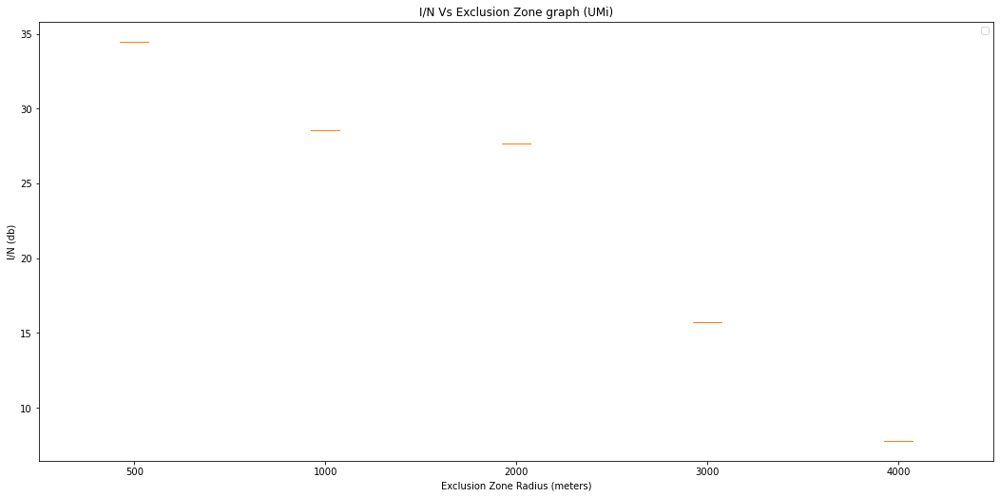

In [38]:
# EXCLUSION ZONE

# Creating dataset
# distance, interface_Noise = pairs_noAverage['UMi']
distance, interface_Noise = pairs['UMi']
 
# print(box_dict_UMi)
 
fig, ax = plt.subplots()

# Creating plot
for i, exclusion_zone in enumerate(exclusion_zones):
    # key is exclusion zone
#     ax.boxplot(interface_Noise[exclusion_zone],
     ax.boxplot([interface_Noise[exclusion_zone]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white'))

# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in exclusion_zones])
 
ax.set_title('I/N Vs Exclusion Zone graph (UMi)')
ax.set_xlabel('Exclusion Zone Radius (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('FSS_8_graphUmiexclusionsum5km.pdf', dpi=100)
plt.show()

In [40]:
pairs['UMi'][1]

{500: 34.48005429791807,
 1000: 28.56141776029513,
 2000: 27.64027228177185,
 3000: 15.693695037848588,
 4000: 7.794497459761183}

In [32]:
len(pairs_noAverage['UMi'][1][2000])/10

25.0

2022-11-08 04:03:12,986 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


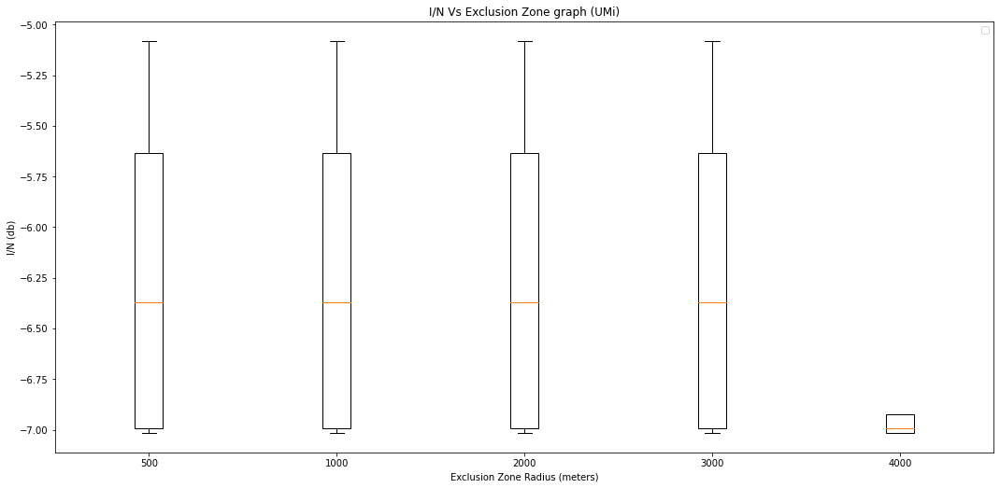

In [52]:
# EXCLUSION ZONE (-15db BS)

# Creating dataset
distance, interface_Noise = pairs_noAverage['UMi']
# distance, interface_Noise = pairs['UMi']
 
# print(box_dict_UMi)
 
fig, ax = plt.subplots()

# Creating plot
for i, exclusion_zone in enumerate(exclusion_zones):
    # key is exclusion zone
#     ax.boxplot(interface_Noise[exclusion_zone],
     ax.boxplot( [x for x in  interface_Noise[exclusion_zone] if x < -5], #(lowest could be -7db)
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white'))

# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in exclusion_zones])
 
ax.set_title('I/N Vs Exclusion Zone graph (UMi)')
ax.set_xlabel('Exclusion Zone Radius (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('FSS_8_-15db_aggregate_omni_graphUmiexclusion5km.pdf', dpi=100)
plt.show()

In [55]:
pairs_noAverage['UMi'] [1]

{500: array([-5.07947817,  3.49517559, -3.21656942, -2.4777952 , -1.02546919,
        -1.21803686, -1.1957749 , -7.01517478,  2.65043479, -5.63549203,
        -3.4098954 ,  3.9996383 ,  4.02072649, -6.99335709,  1.84750619,
        15.27579604, 17.05219782, 21.98710055,  1.89419945, -6.92215913,
        -0.45889416,  6.08200237, -1.21678414, -5.8207021 , -0.34054612,
        -3.80145588, -3.51682947, -3.29592446,  4.06257019,  4.06257019,
         4.06257019,  6.41251677, -1.6894186 , -5.07947817,  3.49517559,
        -3.21656942, -2.4777952 , -1.02546919, -1.21803686, -1.1957749 ,
        -7.01517478,  2.65043479, -5.63549203, -3.4098954 ,  3.9996383 ,
         4.02072649, -6.99335709,  1.84750619, 15.27579604, 17.05219782,
        21.98710055,  1.89419945, -6.92215913, -0.45889416,  6.08200237,
        -1.21678414, -5.8207021 , -0.34054612, -3.80145588, -3.51682947,
        -3.29592446,  4.06257019,  4.06257019,  4.06257019,  6.41251677,
        -1.6894186 , -5.07947817,  3.49517559,

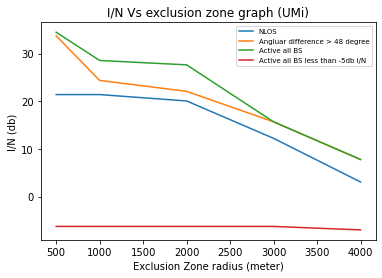

In [72]:
NLOS= {500: 21.40943648560425,
 1000: 21.40943648560425,
 2000: 20.067357698306534,
 3000: 12.229627356762132,
 4000: 3.0778408689863563}


Higher_48={500: 33.7314906875715,
 1000: 24.375104175626966,
 2000: 22.08810672066296,
 3000: 15.693695037848588,
 4000: 7.794497459761183}

all_BS= {500: 34.48005429791807,
 1000: 28.56141776029513,
 2000: 27.64027228177185,
 3000: 15.693695037848588,
 4000: 7.794497459761183}

Neg_5dB = {ex_z: np.mean(np.array([x for x in pairs_noAverage['UMi'][1][ex_z] if x < -5])) for ex_z in pairs_noAverage['UMi'][1] if ex_z > 10}

exclusion_zones = [500, 1000, 2000, 3000, 4000]

plt.plot(exclusion_zones, [NLOS[ex_z] for ex_z in exclusion_zones], label='NLOS')
plt.plot(exclusion_zones, [Higher_48[ex_z] for ex_z in exclusion_zones], label='Angluar difference > 48 degree')
plt.plot(exclusion_zones, [all_BS[ex_z] for ex_z in exclusion_zones], label='Active all BS')
plt.plot(exclusion_zones, [Neg_5dB [ex_z] for ex_z in exclusion_zones] , label='Active all BS less than -5db I/N')


plt.xlabel('Exclusion Zone radius (meter)')
plt.ylabel('I/N (db)')
plt.title('I/N Vs exclusion zone graph (UMi)')
plt.legend(fontsize=7)
# plt.savefig('FSS_8_all_4_together_omni_graphUmiexclusion5km.pdf', dpi=100)
plt.show()

In [69]:
len([x for x in pairs_noAverage['UMi'][1][4000] if x < -5])/10

3.0

In [35]:
# # Creating dataset
# box_dict_UMi = dict{2: I_N_UMi for 2000, 5: I_N_UMi for 5000, 10: I_N_UMi for 10000}
# distance, interface_Noise = pairs_noAverage['UMi']
# for i in range(len(interface_Noise)):
#     if not line_of_sight[i]:
#         continue   
#     if distance[i] not in box_dict_UMi:
#         box_dict_UMi[distance[i]] = []
#     box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# # print(box_dict_UMi)

# fig, ax= plt.subplots()
 
# # Creating plot
# keys = sorted([key for key in box_dict_UMi])
# for i, key in enumerate(keys):
#     # key is distance
#     # print(key)
#     # print(box_dict_UMi[key])
#     line_of_sight1 = box_dict_UMi[key][0][1]
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='blue' if line_of_sight1  else 'red'))
    
# #     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
# #                patch_artist=True,
# #                positions=[i],
# #                boxprops=dict(facecolor='white', color='red' if not line_of_sight1))
                
# # keys = sorted([key for key in box_dict_UMi])
# # ax.boxplot([box_dict_UMi[key] for key in keys])
# ax.set_xticklabels([int(i) for i in keys])

# ax.set_title('I/N Vs Distance graph (UMi LOS)')
# ax.set_xlabel('Distnace of Each BS from FSS (meters)')
# ax.set_ylabel('I/N (db)')
# ax.legend()
 
# # show plot
# # plt.show()
# fig.set_size_inches(18, 8.5)
# # fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
# plt.show()





In [36]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if line_of_sight[i]:
        continue
        
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='blue' if line_of_sight1))
    
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='red' if not line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi NLOS)')
ax.set_xlabel('Distnace of Each BS from FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
plt.show()
    

KeyError: 2

In [ ]:
# Creating dataset
box_dict_UMa = dict()
distance, interface_Noise = pairs_noAverage['UMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMa:
        box_dict_UMa[distance[i]] = []
    box_dict_UMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMa])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMa[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMa[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMa)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUMa.pdf', dpi=100)
plt.show()

In [ ]:
# Creating dataset
box_dict_RMa = dict()
distance, interface_Noise = pairs_noAverage['RMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_RMa:
        box_dict_RMa[distance[i]] = []
    box_dict_RMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_RMa])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_RMa[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_RMa[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (RMa)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphRma.pdf', dpi=100)
plt.show()